# Project4 Used Cars Price Prediction


Zhen Cheng 13040788

Yuliang Guan 17032518

Yonghui Rao 16093645

# Table of Contents
* [Table of Contents](#Table of Contents)
* [Abstract](#Abstract)
* [Introduction](#Introduction)
* [Part 1 Data Acquisition ](#Part-1-Data-Acquisition )
* [Part 2 Data Basic Wrangling & Integration ](#Part-2-Data-Basic-Wrangling-&-Integration )
* [Part 3 Data Analysis ](#Part-3-Data-Analysis )
    * [3.1The most popular car brand in New Zealand ](#3.1-The-most-popular-car-brand-in-New-Zealand )
    * [3.2 The relationship between the displacement and price for the Toyota ](#3.2-The-relationship-between-the-displacement-and-price-for-the-Toyota )
    * [3.3 The relationship between different attributes and price level ](#3.3-The-relationship-between-different-attributes-and-price-level )
    * [3.4 The relationship between car type and price ](#3.4-The-relationship-between-car-type-and-price )
    * [3.5 The relationship between displacement level and price level ](#3.5-The-relationship-between-displacement-level-and-price-level )
    * [3.6 The relationship between mileage, year, and price ](#3.6-The-relationship-between-mileage,-year,-and-price)
* [Part 4 Predictive Model ](#Part-4-Predictive-Model )
    * [4.1 Predict the fuel type(petrol and diesel) based on displacement and price. Used sklearn.linear_model ](#4.1-Predict-the-fuel-type-petrol-or-diesel-based-on-displacement,year-and-price.-Used-sklearn.linear_model )
    * [4.2 Predict the price based on mileage ](#4.2-Predict-the-price-based-on-mileage )
    * [4.3 Predict the price based on displacement.Toyota cars. Used knn ](#4.3-Predict-the-price-based-on-displacement.Toyota-cars.-Used-knn )
    * [4.4 Predict the car type based on displacement and fuel type petrol and diesel ](#4.4-Predict-the-car-type-based-on-displacement-and-fuel-type-petrol-and-diesel )
* [Part 5 Application Price Prediction](#Part-5-Application-Price-Prediction )
    * [5.1 Petrol Car Price Model ](#5.1-Petrol-Car-Price-Model )
    * [5.2 Diesel Car Price Model ](#5.2-Diesel-Car-Price-Model )
    * [5.3 Hybrid Car Price Model](#5.3-Hybrid-Car-Price-Model )
    * [5.4 Electric Car Price Model](#5.4-Electric-Car-Price-Model )
* [Part 6 Application](#Part-6-Application )
* [Conclusion](#Conclusion)



# Abstract

**In this project, we scraped the used car data from Trademe website. And save these data to a CSV file for backup. Then we did the wrangling and integration, prepare for subsequent analysis and prediction. We did some analysis of this data and find some relationship in these data. We use some predictive model to do some predict for this dataset. Prediction can help us to find a new relationship in this dataset. Finally we found out the relationship between all the data, and use the predictive model to complete a prediction application. We used C# to build the UI and connect to Python prediction script. We can enter the parameters of the used car to the application and get a predicted price. **

# Introduction

**In New Zealand, used car trading is very common. As the largest online trading site in New Zealand, Trademe's second-hand car data is very representative. However, there are many factors that determine the price of used cars, such as brand, year, mileage, displacement, energy type and gearbox type. Trademe has tens of thousands of used car information, simply browsing the site is difficult to have a concept for used car prices. It is necessary to carry out an analysis of these data. After finding the relationship of the data, the appropriate prediction model can be used to predict the required data. The second-hand car market to a certain extent reflects the entire New Zealand auto market. **

# Part 1 Data Acquisition 

In [2]:
!python --version

Python 2.7.13 :: Anaconda, Inc.


In [3]:
#!python -m pip install -U pip

In [4]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [5]:
import requests                 
from bs4 import BeautifulSoup 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
from time import sleep


import matplotlib as mpl
import seaborn as sns
import numpy as np
import datetime as dt

import statsmodels.formula.api as smf
import mpld3
from sklearn import preprocessing
import zipfile as zf
import csv


In [6]:
from mpl_toolkits.mplot3d import Axes3D

In [7]:
import patsy

In [8]:
import warnings
warnings.filterwarnings("ignore")

In [9]:
import pandas as pd
import matplotlib as mpl
import seaborn as sns
import math 
from sklearn import neighbors

%matplotlib inline

In [10]:
pd.__version__

u'0.20.3'

In [11]:
pd.options.display.max_columns = 50
from pylab import rcParams

sns.set(style="ticks")
#sns.set_style("whitegrid")
rcParams['figure.dpi'] = 350
rcParams['lines.linewidth'] = 2
rcParams['axes.facecolor'] = 'white'
rcParams['patch.edgecolor'] = 'white'
rcParams['font.family'] = 'StixGeneral'
rcParams['figure.figsize'] = 15,10
rcParams['font.size'] = 20

In [12]:
rcParams['axes.labelsize'] = 'medium'
rcParams['xtick.labelsize'] = 15
rcParams['ytick.labelsize'] = 15


**Scrape the second hand data from the Trademe website**

In [13]:
itemname = []
iteminfo = []
itemprice =[]

In [14]:
def car_scrape(page_start,page_end):
    
    #itemname = []
    #iteminfo = []
    #itemprice =[]
    
    for page_num in range(page_start,page_end):
        print page_num
        href = 'https://www.trademe.co.nz/browse/categoryattributesearchresults.aspx?page='+str(page_num)+'&search=1&cid=268&sidebar=1&5=&14=&18=0%2C0&24=0%2C0&54=&searchRegion=100&sidebarSearch_keypresses=0&sidebarSearch_suggested=0'
    
        response = requests.get(href)
        print response
        page_trademe = response.content
        soup = BeautifulSoup(page_trademe, "lxml")
        trademe_cont_soup = soup.find_all('li',{'class':'listingCard HighlightMotorMultiple lastCard'})
        price_list = soup.find_all('a',{'class','listingPrice'})
        if page_num <=400:
            for i in trademe_cont_soup:
        
                tradene_cont_soup_item_name = i.find('a',{'class':'dotted'}).text
                #item_name = tradene_cont_soup_info_cont.find('a').text
                tradene_cont_soup_item_info = i.find('div',{'class':'rightArrows'}).text
                tradene_cont_soup_item_price = i.find('a',{'class':'listingPrice'}).text
        
                itemname.append(tradene_cont_soup_item_name)
                iteminfo.append(tradene_cont_soup_item_info)
                itemprice.append(tradene_cont_soup_item_price)
        
        if page_num >= 231:
            trademe_cont_soup2 = soup.find_all('li',{'class':'listingCard'})
        
            for a in trademe_cont_soup2:
                tradene_cont_soup_item_name2 = a.find('a',{'class':'dotted'}).text
                #item_name = tradene_cont_soup_info_cont.find('a').text
                tradene_cont_soup_item_info2 = a.find('div',{'class':'rightArrows'}).text
                tradene_cont_soup_item_price2 = a.find('a',{'class':'listingPrice'}).text
        
                itemname.append(tradene_cont_soup_item_name2)
                iteminfo.append(tradene_cont_soup_item_info2)
                itemprice.append(tradene_cont_soup_item_price2)
        

In [15]:
page_start=1
page_end=641
#car_scrape(page_start,page_end)  # uncomment this line to grab data from Trademe

In [16]:
itemname_s = pd.Series(itemname)
iteminfo_s = pd.Series(iteminfo)
itemprice_s = pd.Series(itemprice)

In [17]:
item_all_ori = {'itemname':itemname_s,
               'iteminfo':iteminfo_s,
               'itemprice':itemprice_s}
item_all_ori_df = pd.DataFrame(item_all_ori)
item_all_ori_df.head()

,iteminfo,itemname,itemprice


In [18]:
item_all_ori_df = item_all_ori_df[['itemname', 'iteminfo', 'itemprice']]

In [19]:
#item_all_ori_df.to_csv('trademe_used_car.csv', index=False, encoding = 'utf-8') # Uncomment this line to save data

**Save the dataframe to a csv file for backup**

# Part 2 Data Basic Wrangling & Integration

**Because the data scraped from the website is very littery，so we do the basic wrangling and integration. **

In [20]:
car_data = pd.io.parsers.read_csv(
    "trademe_used_car.csv",
    )
car_data.head(10)


,itemname,iteminfo,itemprice
0,Volkswagen Polo 1.4 2006,"64,000km, Hatchback, 1389cc petrol engine, aut...","$5,500"
1,Toyota Estima 2008,"109,948km, Van, 2362cc petrol engine, automatic","$12,500"
2,Mazda Demio 2 /NEW SHAPE 2009,"76,591km, Hatchback, 1300cc petrol engine, aut...","$6,490"
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ... ...,"52,241km, Hatchback, 2400cc petrol engine, aut...","$10,990"
4,BMW 320i M SPECK 2001,"160,869km, Sedan, 2170cc petrol engine, automatic",NaN
5,Mazda Atenza 2002,"117,000km, Sedan, 2260cc petrol engine, tiptronic","$7,799"
6,Toyota Corolla Gx 2011,"88,800km, Hatchback, 1798cc petrol engine, manual","$12,790"
7,"Holden Commodore VL 3.0 GTS ""BARN FIND"" 1987","77,000km, Sedan, 2968cc petrol engine, manual","$18,950"
8,Toyota Hilux D/C 2004,"461,575km, Ute, 2986cc diesel engine, manual","$7,000"
9,Mazda 3 GLX SPORTHATCH (NZNEW) 2013,"81,880km, Hatchback, 2000cc petrol engine, aut...","$16,450"


In [21]:

car_data['year'] = car_data['itemname'].str[-4:]
car_data['name'] = car_data['itemname'].str[:-4]

car_data.head(5)

,itemname,iteminfo,itemprice,year,name
0,Volkswagen Polo 1.4 2006,"64,000km, Hatchback, 1389cc petrol engine, aut...","$5,500",2006,Volkswagen Polo 1.4
1,Toyota Estima 2008,"109,948km, Van, 2362cc petrol engine, automatic","$12,500",2008,Toyota Estima
2,Mazda Demio 2 /NEW SHAPE 2009,"76,591km, Hatchback, 1300cc petrol engine, aut...","$6,490",2009,Mazda Demio 2 /NEW SHAPE
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ... ...,"52,241km, Hatchback, 2400cc petrol engine, aut...","$10,990",2008,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...
4,BMW 320i M SPECK 2001,"160,869km, Sedan, 2170cc petrol engine, automatic",NaN,2001,BMW 320i M SPECK


In [22]:
brandori = []
brand = []
for index,row in enumerate(car_data['itemname']):
    brandsplit = row.split(' ',1)
    brandori.append(brandsplit)
for i in brandori:
    brand.append(i[0])
car_data.insert(0,'brand',brand)

In [23]:
car_data.head()

,brand,itemname,iteminfo,itemprice,year,name
0,Volkswagen,Volkswagen Polo 1.4 2006,"64,000km, Hatchback, 1389cc petrol engine, aut...","$5,500",2006,Volkswagen Polo 1.4
1,Toyota,Toyota Estima 2008,"109,948km, Van, 2362cc petrol engine, automatic","$12,500",2008,Toyota Estima
2,Mazda,Mazda Demio 2 /NEW SHAPE 2009,"76,591km, Hatchback, 1300cc petrol engine, aut...","$6,490",2009,Mazda Demio 2 /NEW SHAPE
3,Toyota,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ... ...,"52,241km, Hatchback, 2400cc petrol engine, aut...","$10,990",2008,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...
4,BMW,BMW 320i M SPECK 2001,"160,869km, Sedan, 2170cc petrol engine, automatic",NaN,2001,BMW 320i M SPECK


In [24]:
add_cols = ['km', 'car_type','displacement', 'fuel','transmission']

In [25]:
def extractInfos(x):
    km = 0
    car_type = ''
    displacement = ''
    fuel = ''
    transmission = ''

    km_loc = x.find('km,')
    km_str = x[0:km_loc]
    km = int(filter(str.isdigit, km_str))
    left = x[km_loc + 3:]
    infoArray = left.split(',')
    if(len(infoArray) > 0): 
        car_type = infoArray[0]
    if(len(infoArray) > 2): 
        transmission = infoArray[2]
    if (len(infoArray) > 1):
        engine_info = infoArray[1]
        engine_info_array = engine_info.split(' ')
        if(len(engine_info_array) > 2):
            displacement =  engine_info_array[1]
            fuel =  engine_info_array[2]
    return [km, car_type, displacement, fuel, transmission]

In [26]:
lambdafunc = lambda x: pd.Series(extractInfos(x))

In [27]:
newcols = car_data.iteminfo.apply(lambdafunc)
newcols.columns = add_cols
car_data = car_data.join(newcols) 
car_data.head(5)


,brand,itemname,iteminfo,itemprice,year,name,km,car_type,displacement,fuel,transmission
0,Volkswagen,Volkswagen Polo 1.4 2006,"64,000km, Hatchback, 1389cc petrol engine, aut...","$5,500",2006,Volkswagen Polo 1.4,64000,Hatchback,1389cc,petrol,automatic
1,Toyota,Toyota Estima 2008,"109,948km, Van, 2362cc petrol engine, automatic","$12,500",2008,Toyota Estima,109948,Van,2362cc,petrol,automatic
2,Mazda,Mazda Demio 2 /NEW SHAPE 2009,"76,591km, Hatchback, 1300cc petrol engine, aut...","$6,490",2009,Mazda Demio 2 /NEW SHAPE,76591,Hatchback,1300cc,petrol,automatic
3,Toyota,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ... ...,"52,241km, Hatchback, 2400cc petrol engine, aut...","$10,990",2008,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,52241,Hatchback,2400cc,petrol,automatic
4,BMW,BMW 320i M SPECK 2001,"160,869km, Sedan, 2170cc petrol engine, automatic",NaN,2001,BMW 320i M SPECK,160869,Sedan,2170cc,petrol,automatic


In [28]:
car_data = car_data.dropna()       
car_data['itemprice'].replace(regex=True,inplace=True,to_replace=r'\D',value=r'')
car_data['price'] = pd.to_numeric(car_data['itemprice'], errors='coerce')
car_data['displacement'].replace(regex=True,inplace=True,to_replace=r'\D',value=r'')
car_data['displacement'] = pd.to_numeric(car_data['displacement'], errors='coerce')
car_data['year'] = pd.to_numeric(car_data['year'], errors='coerce')
car_data.head(5)

,brand,itemname,iteminfo,itemprice,year,name,km,car_type,displacement,fuel,transmission,price
0,Volkswagen,Volkswagen Polo 1.4 2006,"64,000km, Hatchback, 1389cc petrol engine, aut...",5500,2006,Volkswagen Polo 1.4,64000,Hatchback,1389.0,petrol,automatic,5500
1,Toyota,Toyota Estima 2008,"109,948km, Van, 2362cc petrol engine, automatic",12500,2008,Toyota Estima,109948,Van,2362.0,petrol,automatic,12500
2,Mazda,Mazda Demio 2 /NEW SHAPE 2009,"76,591km, Hatchback, 1300cc petrol engine, aut...",6490,2009,Mazda Demio 2 /NEW SHAPE,76591,Hatchback,1300.0,petrol,automatic,6490
3,Toyota,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ... ...,"52,241km, Hatchback, 2400cc petrol engine, aut...",10990,2008,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,52241,Hatchback,2400.0,petrol,automatic,10990
5,Mazda,Mazda Atenza 2002,"117,000km, Sedan, 2260cc petrol engine, tiptronic",7799,2002,Mazda Atenza,117000,Sedan,2260.0,petrol,tiptronic,7799


In [29]:
car_full_data = car_data[['name','brand', 'year','km','car_type', 'displacement', 'fuel', 'transmission', 'price']]
car_full_data.head(5)

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,1389.0,petrol,automatic,5500
1,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,1300.0,petrol,automatic,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
5,Mazda Atenza,Mazda,2002,117000,Sedan,2260.0,petrol,tiptronic,7799


In [30]:
car_full_data['car_type'] = car_full_data['car_type'].str.strip()
car_full_data['transmission'] = car_full_data['transmission'].str.strip()
print car_full_data.fuel.unique()
print car_full_data.car_type.unique()
print car_full_data.transmission.unique()

['petrol' 'diesel' 'hybrid' 'engine' '' '1' 'alternative' 'electric' 'lpg'
 '5' '2']
['Hatchback' 'Van' 'Sedan' 'Ute' 'Station Wagon' 'RV/SUV' 'Other'
 'Convertible' 'Coupe']
['automatic' 'tiptronic' 'manual' '' 'petrol engine']


## Remove Useless Data

In [31]:
car_full_data[(car_full_data.displacement < 800) & (car_full_data.fuel != 'electric')].head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
207,Chevrolet Camaro,Chevrolet,1970,57000,Coupe,350.0,petrol,manual,90000
210,Cadillac Other Eldorado,Cadillac,1964,80000,Convertible,429.0,petrol,automatic,80000
456,Mazda BT-50 GLX,Mazda,2016,22000,Ute,3.0,diesel,manual,38000
595,MINI One,MINI,2009,61000,Hatchback,1.0,petrol,manual,9999
629,MINI One,MINI,2009,61000,Hatchback,1.0,petrol,manual,9999


**There are meaningless rows, it seems not possible that a vehicle has a displacement smaller than 800 if it is not an electric vehicle, so remove useless rows.**

In [32]:
car_full_data = car_full_data[(car_full_data.fuel == 'electric') | (car_full_data.displacement > 800)]
len(car_full_data)

22064

In [33]:
print car_full_data.transmission.unique()

['automatic' 'tiptronic' 'manual' '' 'petrol engine']


In [34]:
car_full_data_ana = car_full_data.reset_index(drop=True)

In [35]:
car_full_data_ana.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,1389.0,petrol,automatic,5500
1,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,1300.0,petrol,automatic,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
4,Mazda Atenza,Mazda,2002,117000,Sedan,2260.0,petrol,tiptronic,7799


In [36]:
del car_full_data['brand']

In [37]:
mask = (car_full_data["fuel"] == 'hybrid') | (car_full_data["fuel"] == 'petrol') | (car_full_data["fuel"] == 'diesel') | (car_full_data["fuel"] == 'electric')
car_full_data = car_full_data.ix[mask]
mask = (car_full_data["transmission"] == 'automatic') | (car_full_data["transmission"] == 'manual') | (car_full_data["transmission"] == 'tiptronic')
car_full_data = car_full_data.ix[mask]
print "After removing useless data, the length of rows is ", len(car_full_data)

After removing useless data, the length of rows is  21267


In [38]:
car_full_data = pd.get_dummies(car_full_data, columns=['car_type','fuel','transmission'])

In [39]:

car_full_data.head(5)

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV/SUV,car_type_Sedan,car_type_Station Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
0,Volkswagen Polo 1.4,2006,64000,1389.0,5500,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
1,Toyota Estima,2008,109948,2362.0,12500,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0
2,Mazda Demio 2 /NEW SHAPE,2009,76591,1300.0,6490,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,2008,52241,2400.0,10990,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
5,Mazda Atenza,2002,117000,2260.0,7799,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1


.

# Part 3 Data Analysis

## 3.1 The most popular car brand in New Zealand

**First of all, we need to know the number of second-hand car brands.  **

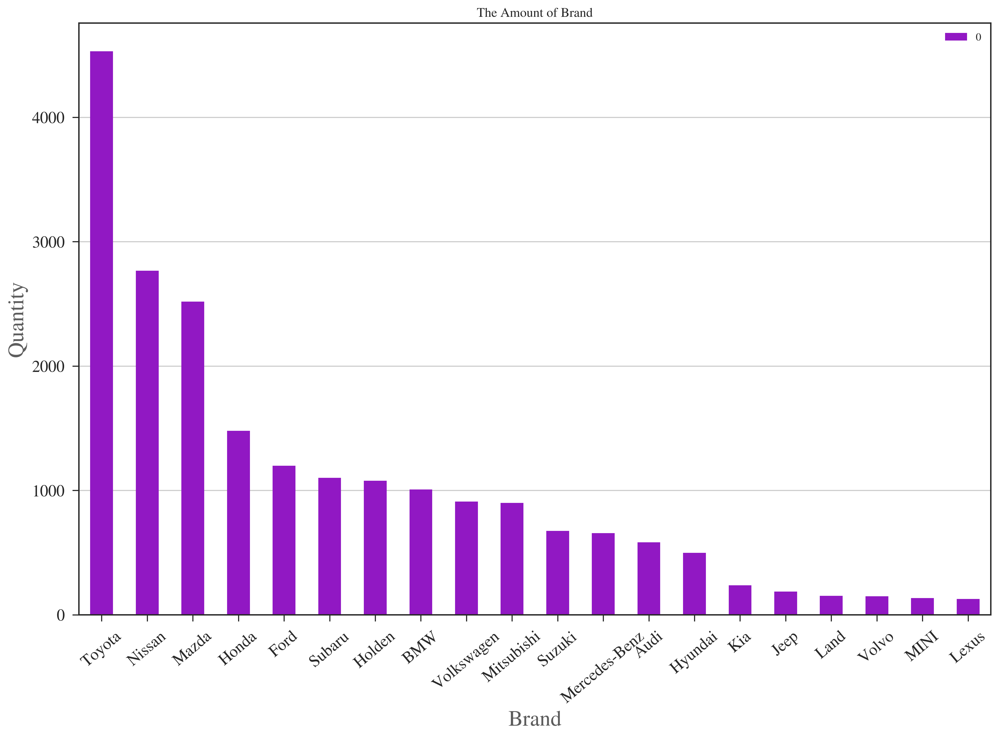

In [40]:
brandsum = car_full_data_ana.groupby('brand').size()
brandsum_df = pd.DataFrame(brandsum)
brandsum_df_top20 = brandsum_df.sort_values(0,ascending = False).head(20)
brandsum_df_top20bar = brandsum_df_top20.plot(kind='bar',title='The Amount of Brand',rot=40,color='#9118c3')
plt.ylabel('Quantity', alpha=0.75)
plt.xlabel('Brand', alpha=0.75)
ax = plt.gca()
ax.yaxis.grid(True)

**In the above figure we can see that on all used cars, the largest number of three brands are Japanese brands which are Toyuta, Nissan and Mazda. This shows that Japanese brands are relatively more popular in New Zealand. And the number of these three brands cars is much higher than other brands.**

**As in all used cars, some cars are very old years, so we only analysis the latest five years used cars.**

In [41]:
car_2013ssss = car_full_data_ana[car_full_data_ana.year == 2013]
car_2013ssss.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
8,Mazda 3 GLX SPORTHATCH (NZNEW),Mazda,2013,81880,Hatchback,2000.0,petrol,automatic,16450
13,Volkswagen Passat AllTrack TDi 125Kw,Volkswagen,2013,162394,Station Wagon,1968.0,diesel,automatic,18800
47,Ford Fiesta 1.6D Manual,Ford,2013,83000,Hatchback,1600.0,diesel,manual,14450
52,"Toyota Aqua Hybrid,",Toyota,2013,92400,Hatchback,1496.0,hybrid,automatic,10990
70,Lexus CT 200h Hybrid NZ New,Lexus,2013,88695,Hatchback,1800.0,petrol,automatic,22950


In [42]:
def brandsum_2013_17(x):
    car_2013 = car_full_data_ana[car_full_data_ana.year == x]
    car_2014 = car_full_data_ana[car_full_data_ana.year == x+1]
    car_2015 = car_full_data_ana[car_full_data_ana.year == x+2]
    car_2016 = car_full_data_ana[car_full_data_ana.year == x+3]
    car_2017 = car_full_data_ana[car_full_data_ana.year == x+4 ]
    
    colorset = ['#1E90FF','#00FF7F','#FFFF00','#FF8247','#FF6A6A']
    
    brandsum2013 = car_2013.groupby('brand').size()
    brandsum2013_df = pd.DataFrame(brandsum2013)
    brandsum2013_df_top20 = brandsum2013_df.sort_values(0,ascending = False).head(20)
    
    brandsum2014 = car_2014.groupby('brand').size()
    brandsum2014_df = pd.DataFrame(brandsum2014)
    brandsum2014_df_top20 = brandsum2014_df.sort_values(0,ascending = False).head(20)
    
    brandsum2015 = car_2015.groupby('brand').size()
    brandsum2015_df = pd.DataFrame(brandsum2015)
    brandsum2015_df_top20 = brandsum2015_df.sort_values(0,ascending = False).head(20)
    
    brandsum2016 = car_2016.groupby('brand').size()
    brandsum2016_df = pd.DataFrame(brandsum2016)
    brandsum2016_df_top20 = brandsum2016_df.sort_values(0,ascending = False).head(20)
    
    brandsum2017 = car_2017.groupby('brand').size()
    brandsum2017_df = pd.DataFrame(brandsum2017)
    brandsum2017_df_top20 = brandsum2017_df.sort_values(0,ascending = False).head(20)
    
    brandsum_2013_17list = [brandsum2013_df_top20,brandsum2014_df_top20,brandsum2015_df_top20,brandsum2016_df_top20,brandsum2017_df_top20]
    a=-1
    b=2012
    for i in brandsum_2013_17list:
        a = a+1
        b = b + 1
        c = str(b)
        i.plot(kind='bar',rot=40,color=colorset[a],hatch='o')
        plt.ylabel('Quantity', alpha=0.75)
        plt.xlabel('Brand', alpha=0.75)
        plt.title('The Amount of Brand in Rate in '+ c +'' ,alpha=2)
        ax = plt.gca()
        ax.yaxis.grid(True)
    

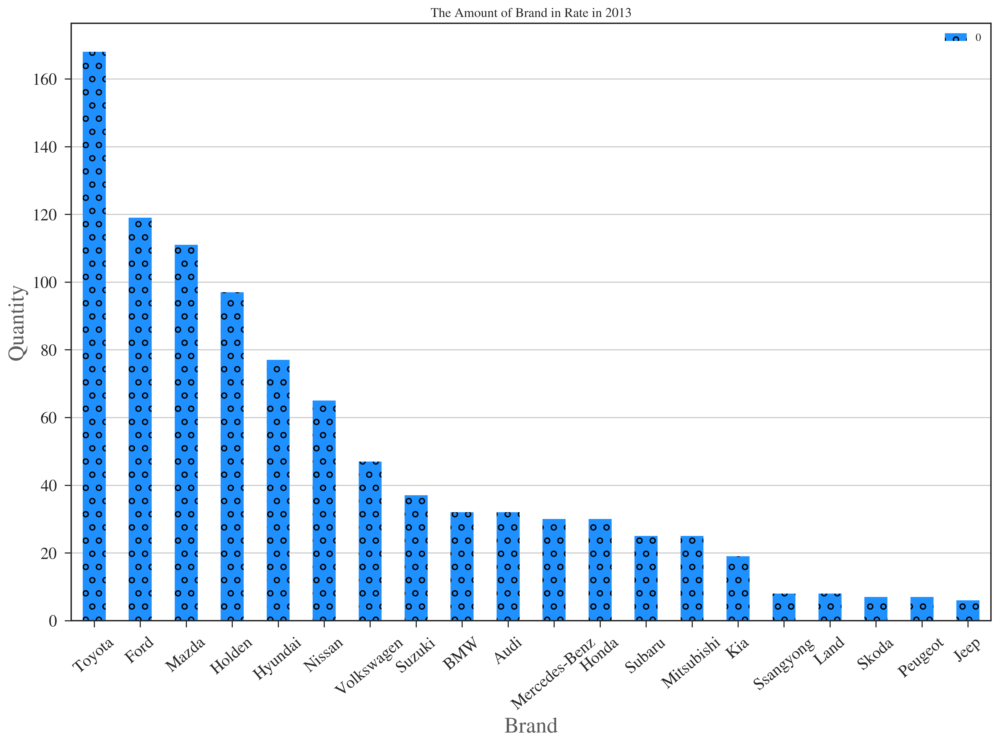

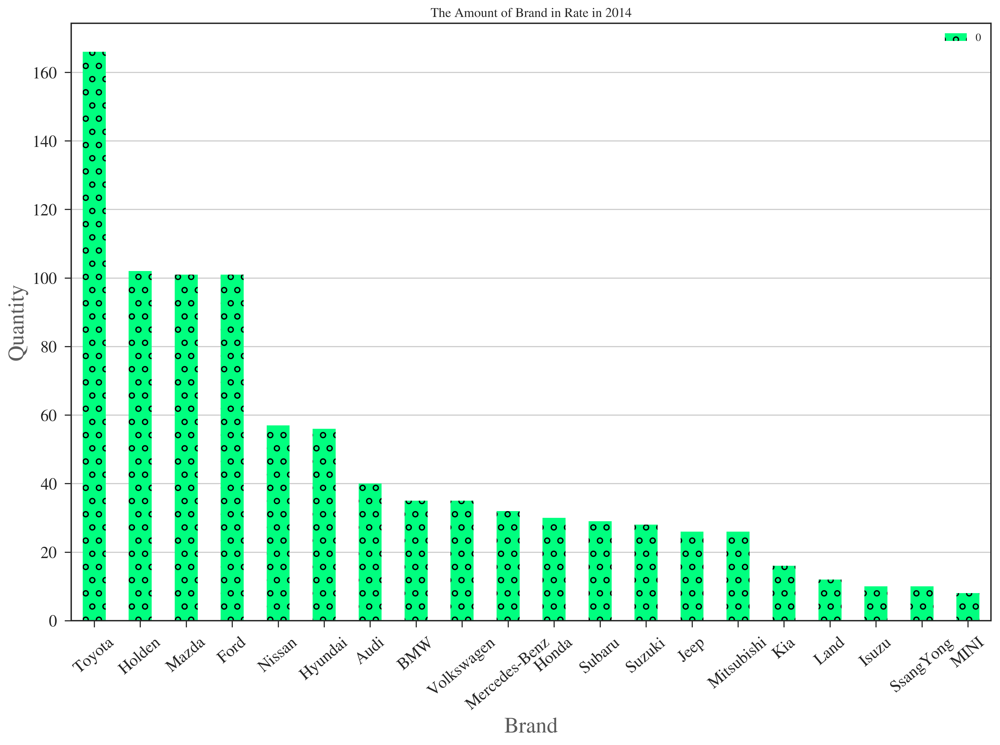

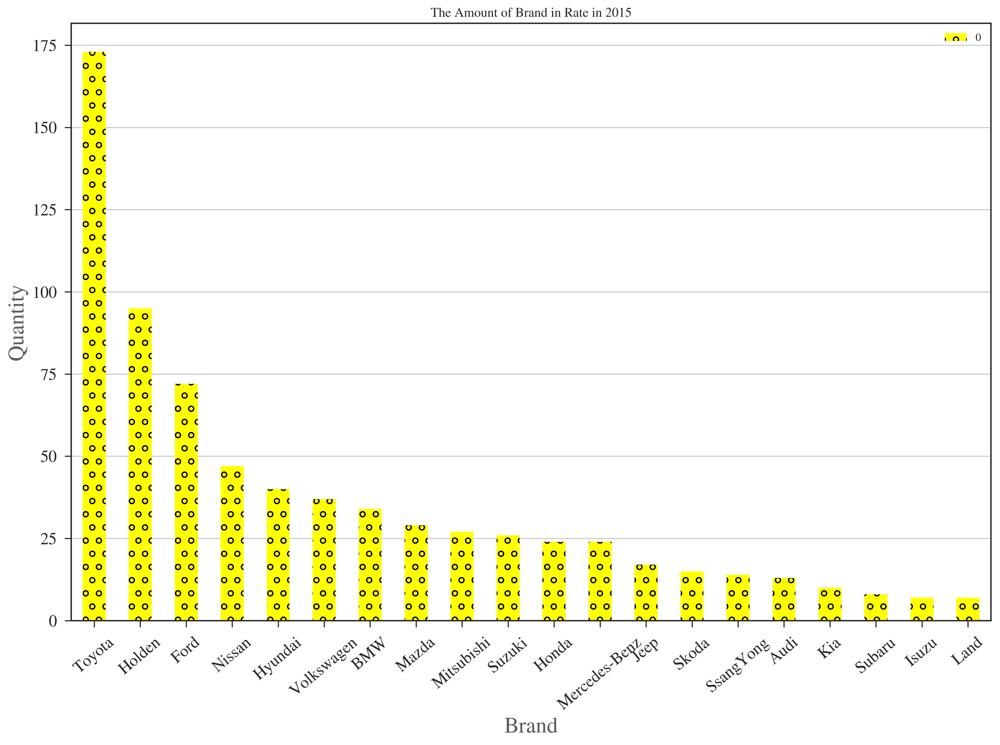

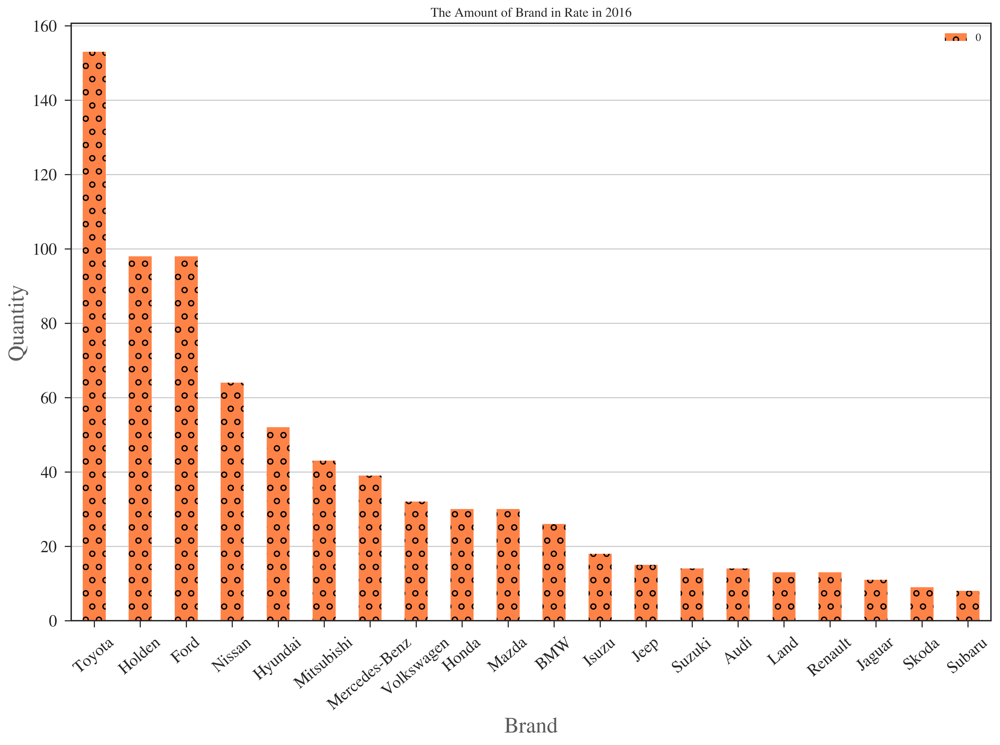

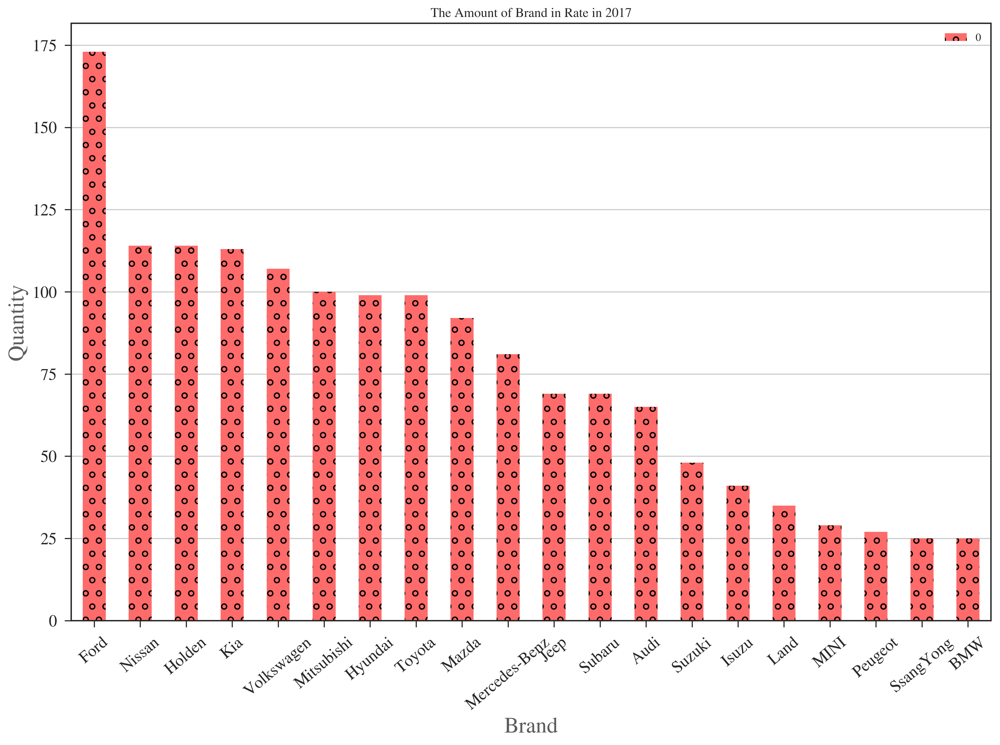

In [43]:
x = 2013
brandsum_2013_17(x)

**The figure above shows the largest number of second-hand car brands in the last five years. In the first four years, the Toyota is the brand with the largest number of used cars. But the number of Ford cars in the past few years gradually increased. In 2017 the number of Ford used cars reached the most. This shows that Ford's car has become more popular in recent years. Horton as the largest car brand in the southern hemisphere, that has been not a low number.  **

.

## 3.2 The relationship between the displacement and price for the Toyota

**As the brand with the largest number of cars in New Zealand. Toyota has a large analytical value. So in this part, we have analysed the relationship between the displacement and price of Toyota. **

In [44]:
Toyota_full_data = car_full_data_ana[(car_full_data_ana.brand == 'Toyota')]
Toyota_full_data = Toyota_full_data.reset_index(drop=True)
Toyota_full_data.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
1,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
2,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790
3,Toyota Hilux D/C,Toyota,2004,461575,Ute,2986.0,diesel,manual,7000
4,Toyota Land Cruiser Td,Toyota,2011,118500,Ute,4461.0,diesel,manual,49000


In [45]:
Toyota_trans = Toyota_full_data[(Toyota_full_data.transmission == 'automatic') | (Toyota_full_data.transmission == 'manual') ]
Toyota_trans.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
1,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
2,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790
3,Toyota Hilux D/C,Toyota,2004,461575,Ute,2986.0,diesel,manual,7000
4,Toyota Land Cruiser Td,Toyota,2011,118500,Ute,4461.0,diesel,manual,49000


In [46]:
Toyota_trans_fuel = Toyota_trans[(Toyota_trans.fuel == 'petrol') | (Toyota_trans.fuel == 'diesel') ]
Toyota_trans_fuel_year = Toyota_trans_fuel[Toyota_trans_fuel.year > 2000]
Toyota_trans_fuel_year_price = Toyota_trans_fuel_year[Toyota_trans_fuel_year.price <= 30000]
Toyota_trans_fuel_year_price.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
1,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
2,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790
3,Toyota Hilux D/C,Toyota,2004,461575,Ute,2986.0,diesel,manual,7000
7,Toyota Corolla Fielder,Toyota,2004,130000,Station Wagon,1794.0,petrol,automatic,6500


In [47]:
Toyota_trans_fuel_year_price = Toyota_trans_fuel_year_price.reset_index(drop=True)

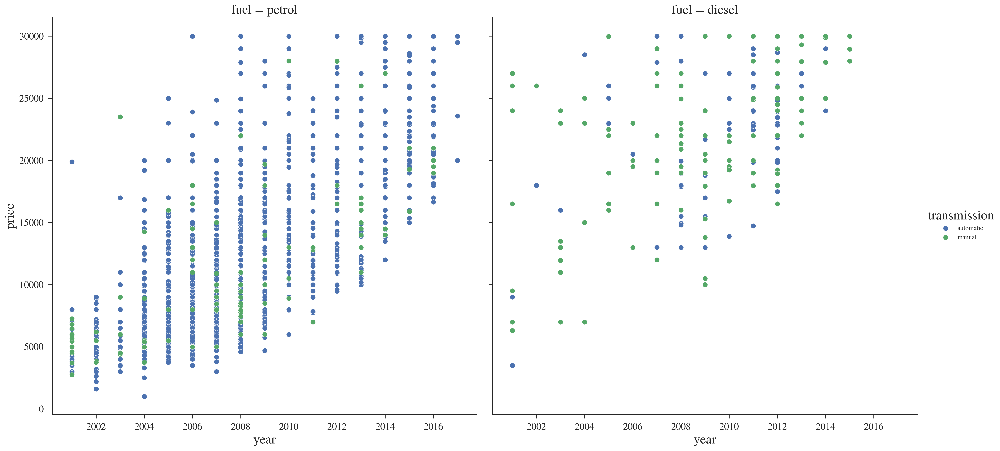

In [48]:
g = sns.FacetGrid(Toyota_trans_fuel_year_price, col="fuel",  hue="transmission", size=10)
g.map(plt.scatter, "year", "price", s=60, edgecolor="w").add_legend()

**In the above figure we can see that in Toyota cars, petrol cars account for the vast majority. And in petrol cars, automatic cars are account for the vast majority, but on the diesel cars, the manual cars are account for the vast majority.  **

.

## 3.3 The relationship between different attributes and price level

**We classify the price to four levels. The first level is between 500 to 10000 dollar. The second level is between 10000 to 20000 dollar. The third level is between 20000 to 30000 dollar. The fourth level is between 30000 to 40000 dollar. **

In [49]:
Toyota_trans_fuel_year_price1 = Toyota_trans_fuel_year[Toyota_trans_fuel_year.price <= 40000]
Toyota_trans_fuel_year_price1.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
1,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
2,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790
3,Toyota Hilux D/C,Toyota,2004,461575,Ute,2986.0,diesel,manual,7000
7,Toyota Corolla Fielder,Toyota,2004,130000,Station Wagon,1794.0,petrol,automatic,6500


In [50]:
Toyota_trans_fuel_year_price1.price.describe()

count     3411.000000
mean     13984.251832
std       8579.259192
min       1000.000000
25%       7480.000000
50%      10995.000000
75%      17995.000000
max      39995.000000
Name: price, dtype: float64

In [51]:
toyota_pricetype = [1,2,3,4]
toyota_pricetype_dic = {'price_level':toyota_pricetype}
toyota_pricetype_df = pd.DataFrame(toyota_pricetype_dic)
toyota_pricetype_df

,price_level
0,1
1,2
2,3
3,4


In [52]:
Toyota_price_type= []
for i,items in enumerate(Toyota_trans_fuel_year_price1.price):
    if (items >= 500)&(items<10000):
        price_level_1 = dict(toyota_pricetype_df.ix[0])
        Toyota_price_type.append(price_level_1)
    
    if (items >= 10000)&(items<20000):
        price_level_2 = dict(toyota_pricetype_df.ix[1])
        Toyota_price_type.append(price_level_2)
    
    if (items >= 20000)&(items<30000):
        price_level_3 = dict(toyota_pricetype_df.ix[2])
        Toyota_price_type.append(price_level_3)
        
    if (items >= 30000)&(items<=40000):
        price_level_4 = dict(toyota_pricetype_df.ix[3])
        Toyota_price_type.append(price_level_4)

In [53]:
Toyota_price_type_df = pd.DataFrame(Toyota_price_type)
Toyota_price_type_df.head(2)

,price_level
0,2
1,2


In [54]:
Toyota_trans_fuel_year_price_prtype =  pd.concat([Toyota_trans_fuel_year_price1,Toyota_price_type_df],axis=1,join_axes=[Toyota_trans_fuel_year_price1.index])

In [55]:
Toyota_trans_fuel_year_price_prtype.head(3)

,name,brand,year,km,car_type,displacement,fuel,transmission,price,price_level
0,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500,2.0
1,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990,2.0
2,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790,2.0


In [56]:
Toyota_trans_fuel_year_price_prtype_ana = Toyota_trans_fuel_year_price_prtype[['year','km','displacement','price_level']]

In [57]:
sns.pairplot(Toyota_trans_fuel_year_price_prtype_ana, hue="price_level", size=5, plot_kws={'edgecolor':'w'})

** In the above figure, we can see that the year is closer, the price is higher. The higher the mileage, the lower the price. The higher displacement the higher price. But there are exceptions, perhaps because of the model of the car, such as low-displacement luxury cars.**

.

## 3.4 The relationship between car type and price

In [58]:
car_full_data_af2000 = car_full_data_ana[(car_full_data_ana.year >= 2000)]

In [59]:
typesum = car_full_data_af2000.groupby('car_type').size()
typesum_df = pd.DataFrame(typesum)
typesum_df = typesum_df.sort_values(0,ascending = False).head(20)

In [60]:
cartype = list(typesum_df.index)

In [61]:
typesum_df.insert(0,'car_type',cartype)

In [62]:
len(typesum_df)

9

In [63]:
typesum_df.columns = ['car_type', 'quantity']

In [64]:
typesum_df.head()

,car_type,quantity
car_type,,
Hatchback,Hatchback,5876
RV/SUV,RV/SUV,3991
Sedan,Sedan,3633
Station Wagon,Station Wagon,3206
Van,Van,1752


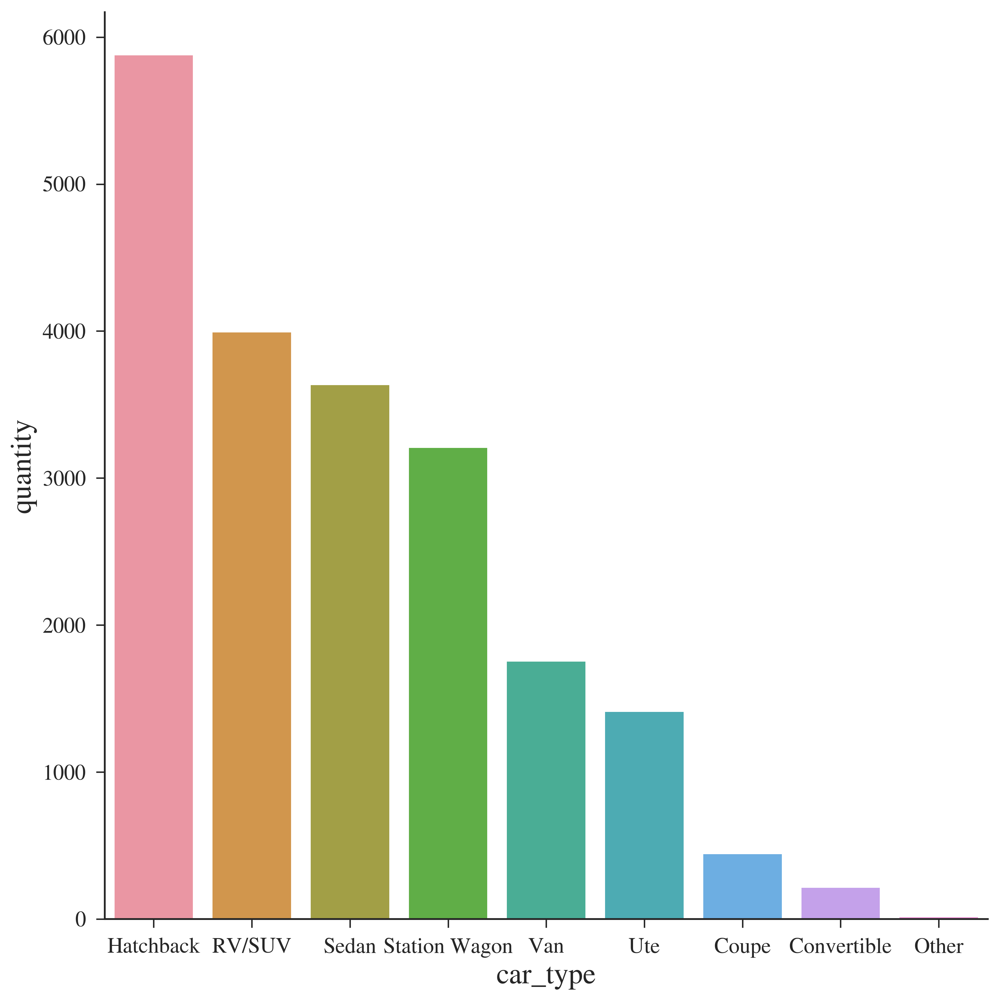

In [65]:
sns.factorplot(data=typesum_df, x="car_type", y='quantity',kind="bar",size = 10)

**In the above figure, we can see that the number of hatchback cars in New Zealand is the largest, followed by RV/SUV**

In [66]:
car_full_data_type= car_full_data_ana[(car_full_data_ana.displacement < 10000) & (car_full_data_ana.price < 150000) & (car_full_data_ana.year >= 2007)]

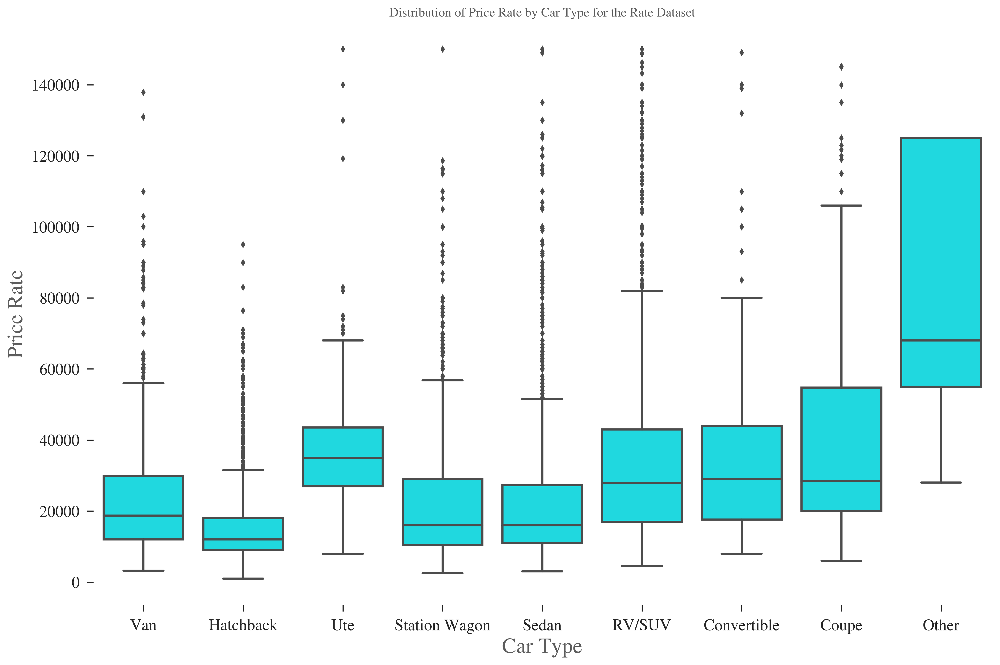

In [67]:
sns.boxplot(x="car_type", y="price", data=car_full_data_type, color="#00F5FF")

sns.despine(left=True, bottom=True)

plt.ylabel('Price Rate', alpha=0.75)
plt.xlabel('Car Type', alpha=0.75)
plt.title('Distribution of Price Rate by Car Type for the Rate Dataset', alpha=0.75)

**In the above figure, we can see that the price range of the Hatchback car is the lowest. This is probably the most popular reason for   Hatchback cars in New Zealand. The price of the highest number of three car models is not particularly high. The Other model cars have the high price. Because this part of the car contains the luxury cars.**

.

## 3.5 The relationship between displacement level and price level

In [68]:
car_full_data_af2010_17 = car_full_data_ana[(car_full_data_ana.year >= 2010)]

In [69]:
car_full_data_af2010_17.displacement.describe()

count     8579.000000
mean      2361.909896
std       1119.480639
min          1.000000
25%       1798.000000
50%       2000.000000
75%       2800.000000
max      30006.000000
Name: displacement, dtype: float64

**We divided the displacement into six levels**

In [70]:
fullcar_displacement_level = [1,2,3,4,5,6]
fullcar_displacement_level_dic = {'displacement_level':fullcar_displacement_level}
fullcar_displacement_level_df = pd.DataFrame(fullcar_displacement_level_dic)

In [71]:
all_displacement_level = []
for i,items in enumerate(car_full_data_af2010_17.displacement):
    if (items > 200)&(items<1000):
        displacement_level_1 = dict(fullcar_displacement_level_df.ix[0])
        all_displacement_level.append(displacement_level_1)
    
    if (items >= 1000)&(items<2000):
        displacement_level_2 = dict(fullcar_displacement_level_df.ix[1])
        all_displacement_level.append(displacement_level_2)
        
    if (items >= 2000)&(items<3000):
        displacement_level_3 = dict(fullcar_displacement_level_df.ix[2])
        all_displacement_level.append(displacement_level_3)
        
    if (items >= 3000)&(items<4000):
        displacement_level_4 = dict(fullcar_displacement_level_df.ix[3])
        all_displacement_level.append(displacement_level_4)
        
    if (items >= 4000)&(items<5000):
        displacement_level_5 = dict(fullcar_displacement_level_df.ix[4])
        all_displacement_level.append(displacement_level_5)
        
    if (items >= 5000):
        displacement_level_6 = dict(fullcar_displacement_level_df.ix[5])
        all_displacement_level.append(displacement_level_6)


In [72]:
all_displacement_level_df = pd.DataFrame(all_displacement_level)
car_full_data_af2010_17_1 = pd.concat([car_full_data_af2010_17,all_displacement_level_df],axis=1,join_axes=[car_full_data_af2010_17.index])
car_full_data_af2010_17_1.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price,displacement_level
5,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790,6.0
8,Mazda 3 GLX SPORTHATCH (NZNEW),Mazda,2013,81880,Hatchback,2000.0,petrol,automatic,16450,3.0
9,Toyota Land Cruiser Td,Toyota,2011,118500,Ute,4461.0,diesel,manual,49000,2.0
10,Toyota Prius G,Toyota,2012,88023,Hatchback,1797.0,hybrid,automatic,16500,2.0
13,Volkswagen Passat AllTrack TDi 125Kw,Volkswagen,2013,162394,Station Wagon,1968.0,diesel,automatic,18800,2.0


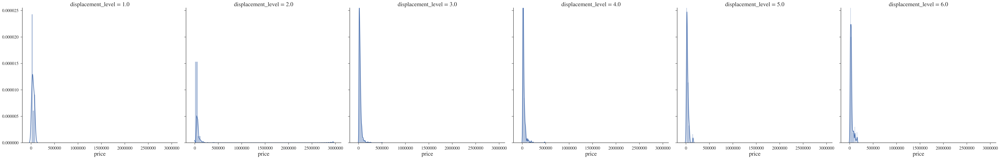

In [73]:
g = sns.FacetGrid(car_full_data_af2010_17_1, col="displacement_level", size = 8)
g.map(sns.distplot, "price")

In [74]:
car_full_data_af2010_17_clean = car_full_data_af2010_17_1[(car_full_data_af2010_17_1.displacement < 10000) & (car_full_data_af2010_17_1.price < 500000)]

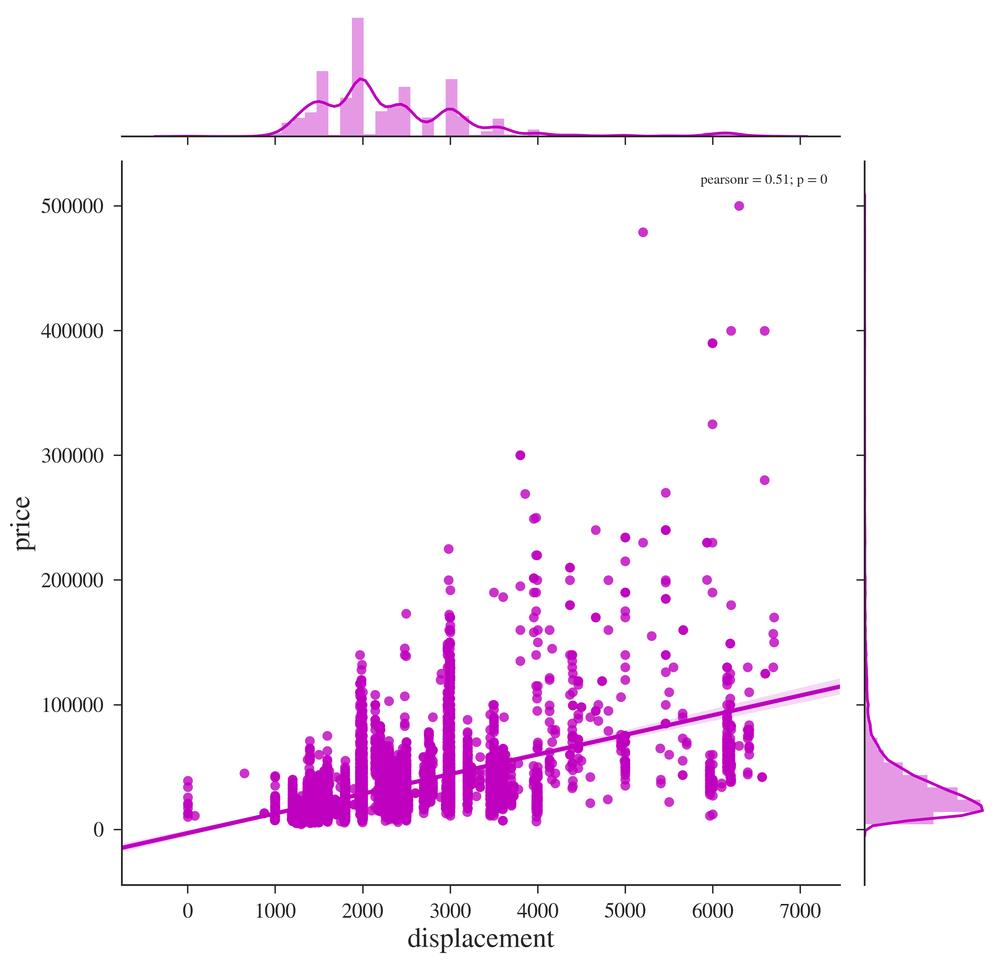

In [75]:
sns.jointplot("displacement", "price", data=car_full_data_af2010_17_clean, kind="reg", color="m", size=10)


**The number of vehicles was the largest of the displacement range between 2000 to 3000. The price of the most of the vehicles is lower than 100000 dollars.**

## 3.6 The relationship between mileage, year, and price

In [76]:
car_full_data_type= car_full_data_ana[(car_full_data_ana.displacement < 10000) & (car_full_data_ana.price < 80000) & (car_full_data_ana.year >= 2000) & (car_full_data_ana.km < 400000)]

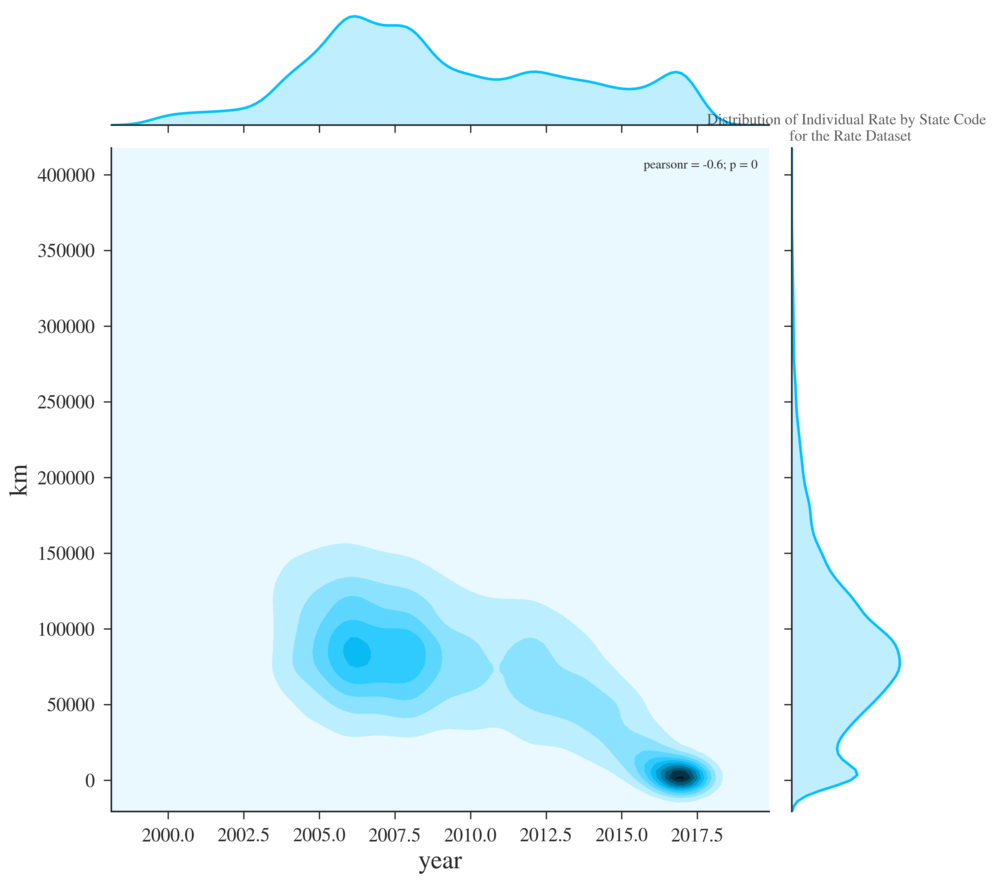

In [77]:
sns.jointplot("year", "km", data=car_full_data_type, kind='kde',size = 10, color = '#00BFFF')

plt.title('Distribution of Individual Rate by State Code \n for the Rate Dataset', alpha=0.75)

**The number of used cars has two peak periods of years. One is about 2007, the other one is about 2017. Most of the mileage of used cars is close to one hundred thousand kilometers. And there are many cars that the mileage close to zero. This part of the used car approached the new car.**

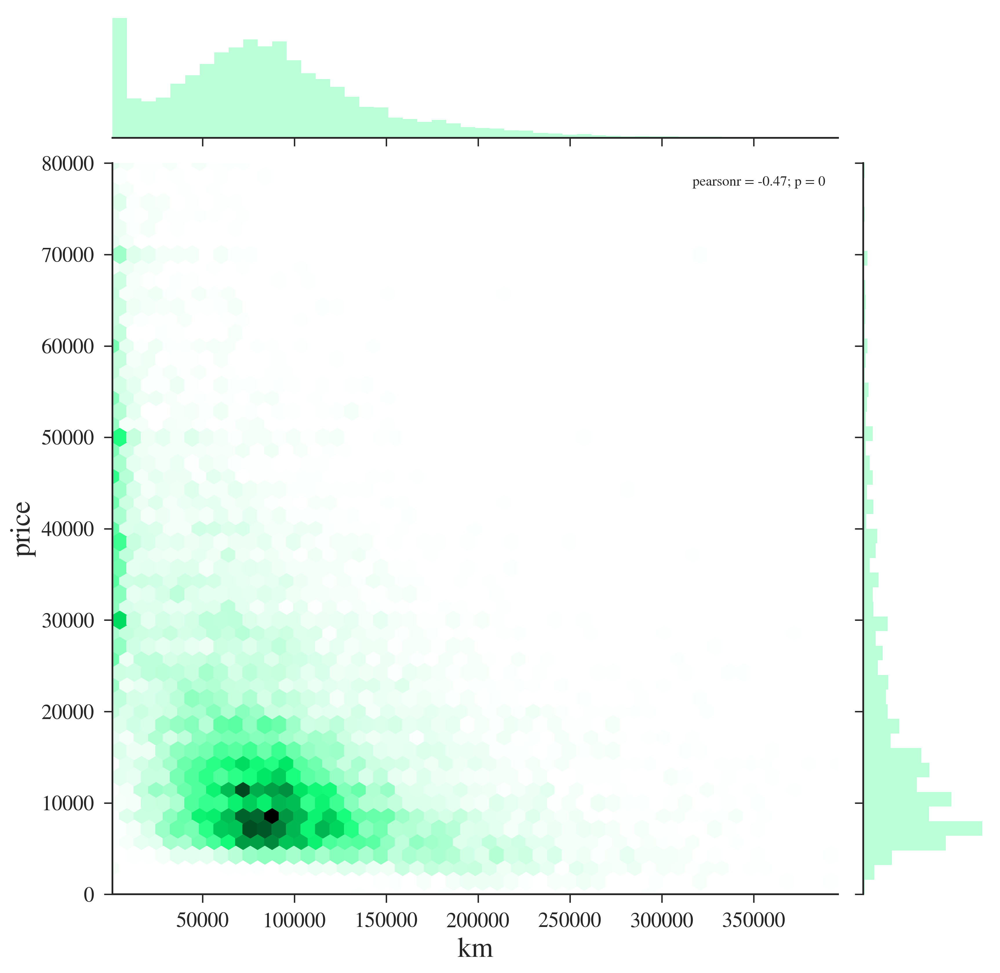

In [78]:
sns.jointplot("km", "price", data=car_full_data_type, kind="hex" ,size = 10, color = '#54FF9F')

**In the above figure, we can see that the price of most of the cars is about 10000 dollars. And the mileage of these cars is close to 100000km. The cars which the mileage is close to zero that the price range is from 20,000 to 60,000 dollars, concentrated in the 40,000 dollars.**

.

# Part 4 Predictive Model

In [79]:
car_full_data_anaPre = car_full_data_ana[(car_full_data_ana.year>=2000) & (car_full_data_ana.km < 450000) & (car_full_data_ana.price < 300000) & (car_full_data_ana.displacement < 10000)]
car_full_data_anaPre.head()


,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,1389.0,petrol,automatic,5500
1,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,automatic,12500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,1300.0,petrol,automatic,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
4,Mazda Atenza,Mazda,2002,117000,Sedan,2260.0,petrol,tiptronic,7799


## 4.1 Predict the fuel type petrol or diesel based on displacement, year and price. Used sklearn.linear_model

**We set the petrol to type 0, the diesel to type 1.**

In [80]:
from sklearn.linear_model import LogisticRegression

In [81]:
car_full_data_anaPre_fueltype = car_full_data_anaPre[(car_full_data_anaPre.fuel == 'petrol') | (car_full_data_anaPre.fuel == 'diesel')]
car_full_data_anaPre_fueltype = car_full_data_anaPre_fueltype[car_full_data_anaPre_fueltype.price <= 100000]
car_full_data_anaPre_fueltype2 = car_full_data_anaPre_fueltype

In [82]:
fule_type_pre_x = car_full_data_anaPre_fueltype

In [83]:
fuel_type = []
for i in car_full_data_anaPre_fueltype.fuel:
    if i == 'petrol':
        fuel_type.append(0)
    if i == 'diesel':
        fuel_type.append(1)

In [84]:
car_full_data_anaPre_fueltype.insert(7,'fuel_type',fuel_type)

In [85]:
fule_type_pre = ['displacement','price','year']

In [86]:
X = fule_type_pre_x.loc[:,fule_type_pre]

In [87]:
X.shape

(19962, 3)

In [88]:
y = car_full_data_anaPre_fueltype.fuel_type

In [89]:
y.shape

(19962L,)

In [90]:
model = LogisticRegression()

In [91]:
model.fit(X, y)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

**Then use this prediction model to predict the fuel type**

In [92]:
X_new = fule_type_pre_x.loc[:,fule_type_pre]

In [93]:
fule_type_pre_result = model.predict(X_new)

In [94]:
fule_type_pre_result

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [95]:
#car_full_data_anaPre_fueltype2.head()

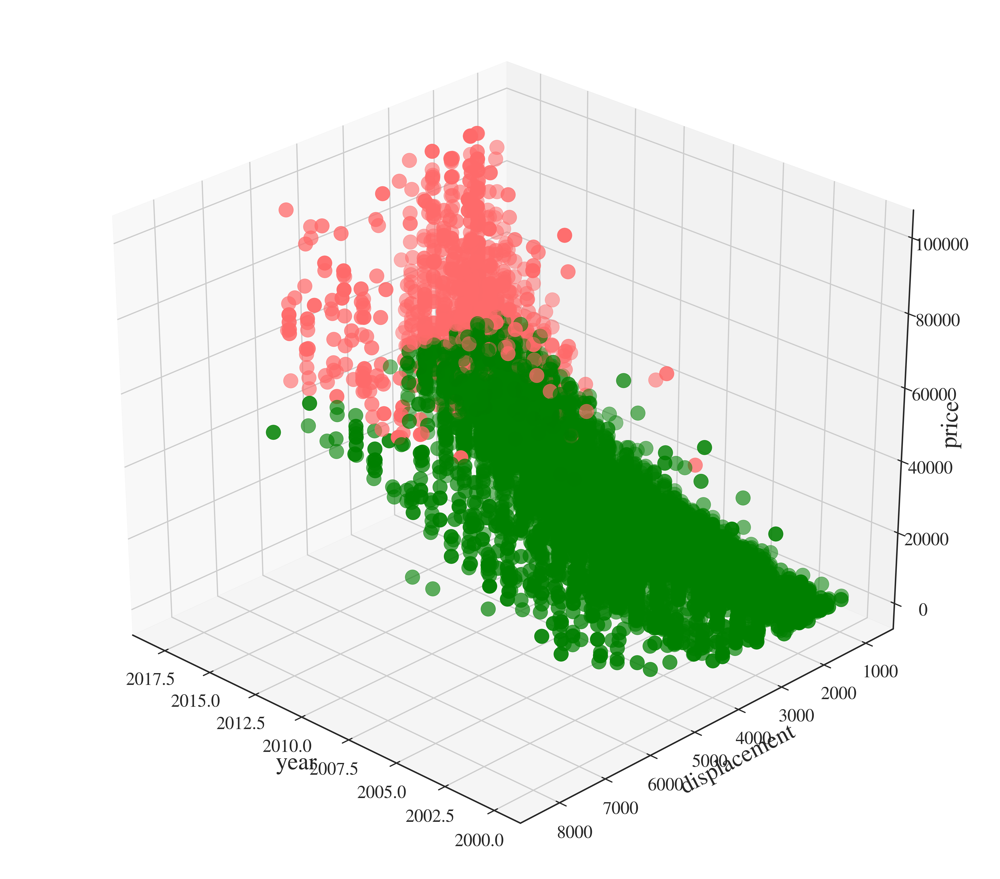

In [96]:
colors = np.array(['green', '#FF6A6A'])

ax = Axes3D(plt.figure(figsize=(12, 10)), rect=[.01, 0, 0.95, 1], elev=30, azim=134)
ax.scatter(fule_type_pre_x.ix[:,'year'], fule_type_pre_x.ix[:,'displacement'], 
           fule_type_pre_x.ix[:,'price'], c = colors[fule_type_pre_result], s=150)
ax.set_xlabel(fule_type_pre_x.columns[2])
ax.set_ylabel(fule_type_pre_x.columns[5])
ax.set_zlabel(fule_type_pre_x.columns[9])

**Get the predicted results and compare the original data**

In [97]:
fule_type_pre_result_list = list(fule_type_pre_result)

In [98]:
car_full_data_anaPre_fueltype.insert(8,'fuel_type_result',fule_type_pre_result_list)

In [99]:
#del car_full_data_anaPre_fueltype['fuel_type_result']

In [100]:
fule_type_compare = car_full_data_anaPre_fueltype[['fuel_type','fuel_type_result']]

In [101]:
fule_type_compare['compare_suma'] = fule_type_compare.apply(lambda x: x.sum(), axis=1)#notice
fule_type_compare.head()

,fuel_type,fuel_type_result,compare_suma
0,0,0,0
1,0,0,0
2,0,0,0
3,0,0,0
4,0,0,0


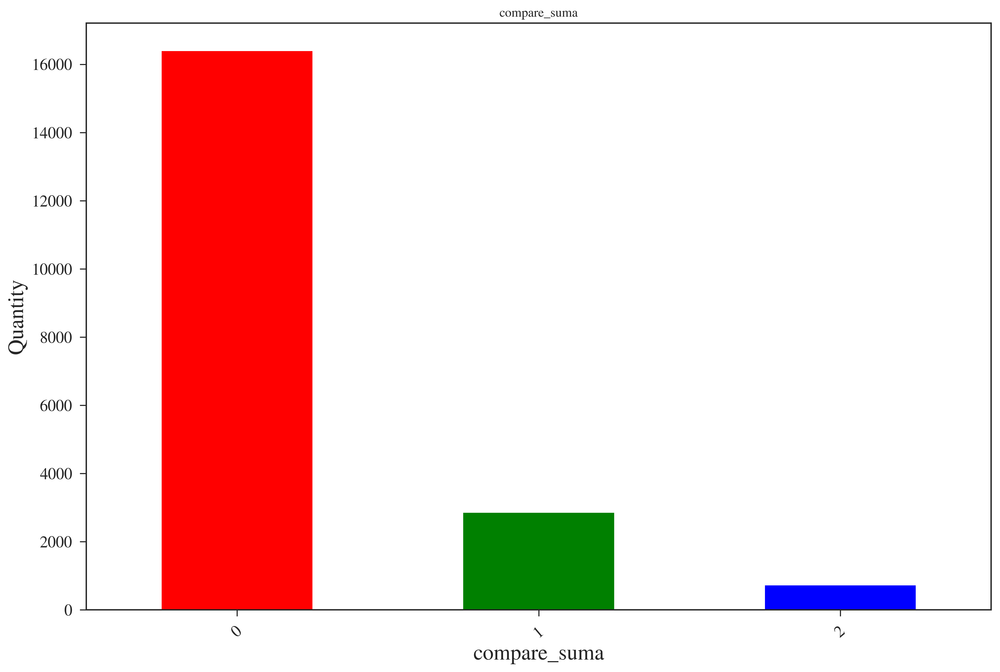

In [102]:
fule_type_comparebar = fule_type_compare['compare_suma'].value_counts().plot(kind='bar',title='compare_suma',rot=40,color='rgb')
fule_type_comparebar .set_xlabel("compare_suma")
fule_type_comparebar .set_ylabel("Quantity")

**We added the predicted results to the original data. If the predictive result is the same as the original result, the result of the addition will only have 0 or 2. So in the above figure, we can see that the accuracy of the predict results is very high.**

.

## 4.2 Predict the price based on mileage

In [103]:
car_full_data_anaPre1 = car_full_data_anaPre[car_full_data_anaPre.year>=2010]
car_line_pre = car_full_data_anaPre1[['displacement','price']]
car_line_pre = car_line_pre.reset_index(drop=True)
car_line_pre.shape

(8562, 2)

In [104]:
car_line_pre_result = car_line_pre

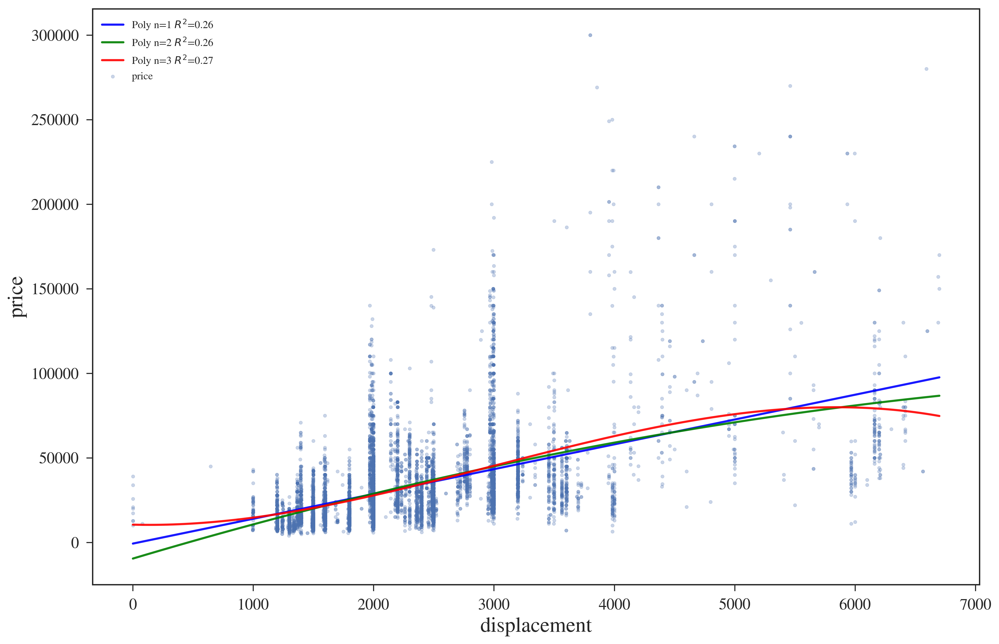

In [105]:
plt.scatter( car_line_pre.displacement, car_line_pre.price, s=10, alpha=0.3)
plt.xlabel('displacement')
plt.ylabel('price')

# points linearlyd space on lstats
x = pd.DataFrame({'displacement': np.linspace(car_line_pre.displacement.min(), car_line_pre.displacement.max(), len(car_line_pre.displacement)) })

# 1-st order polynomial
poly_1 = smf.ols(formula='price ~ 1 + displacement', data=car_line_pre).fit()
plt.plot(x, poly_1.predict(x), 'b-', label='Poly n=1 $R^2$=%.2f' % poly_1.rsquared,  alpha=0.9)

# 2-nd order polynomial
poly_2 = smf.ols(formula='price ~ 1 + displacement + I(displacement ** 2.0)', data=car_line_pre).fit()
plt.plot(x, poly_2.predict(x), 'g-', label='Poly n=2 $R^2$=%.2f' % poly_2.rsquared, alpha=0.9)

# 3-rd order polynomial
poly_3 = smf.ols(formula='price ~ 1 + displacement + I(displacement ** 2.0) + I(displacement ** 3.0)', data=car_line_pre).fit()
plt.plot(x, poly_3.predict(x), 'r-', alpha=0.9,
         label='Poly n=3 $R^2$=%.2f' % poly_3.rsquared)

plt.legend()
#poly_1.mse_resid

In [106]:
Temp_Barometer_pre1 = pd.DataFrame({'displacement':[16]})
qwe = poly_3.predict(Temp_Barometer_pre1)
qwe

0    10455.93279
dtype: float64

**use poly 2 to predict**

In [107]:
displacement_price_liner_result_poly2 = []
for i in car_line_pre.displacement:
    displacement_price_liner_p2_1 = pd.DataFrame({'displacement':[i]})
    displacement_price_liner_p2_12 = poly_2.predict(displacement_price_liner_p2_1)#得到一个array ，array([ 10455.93276865])
    
    displacement_price_liner_p2_12list1 = displacement_price_liner_p2_12.tolist()#转化成list
    displacement_price_liner_p2_12list12 = round(displacement_price_liner_p2_12list1[0],3)#取第里面的值，小数点后三位
    displacement_price_liner_result_poly2.append(displacement_price_liner_p2_12list12)#加到列中

In [108]:
displacement_price_liner_result_poly2[0:5]

[25291.96, 28796.235, 64768.556, 25274.404, 28246.681]

In [109]:
car_line_pre_result.insert(2,'poly2_result',displacement_price_liner_result_poly2 )

In [110]:
car_line_pre_result.head()

,displacement,price,poly2_result
0,1798.0,12790,25291.960
1,2000.0,16450,28796.235
2,4461.0,49000,64768.556
3,1797.0,16500,25274.404
4,1968.0,18800,28246.681


In [111]:
car_line_pre_result_poly2_compare = car_line_pre_result[['price','poly2_result']]#.sample(n=100)  

In [112]:
car_line_pre_result_poly2_compare = car_line_pre_result_poly2_compare.reset_index(drop=True)

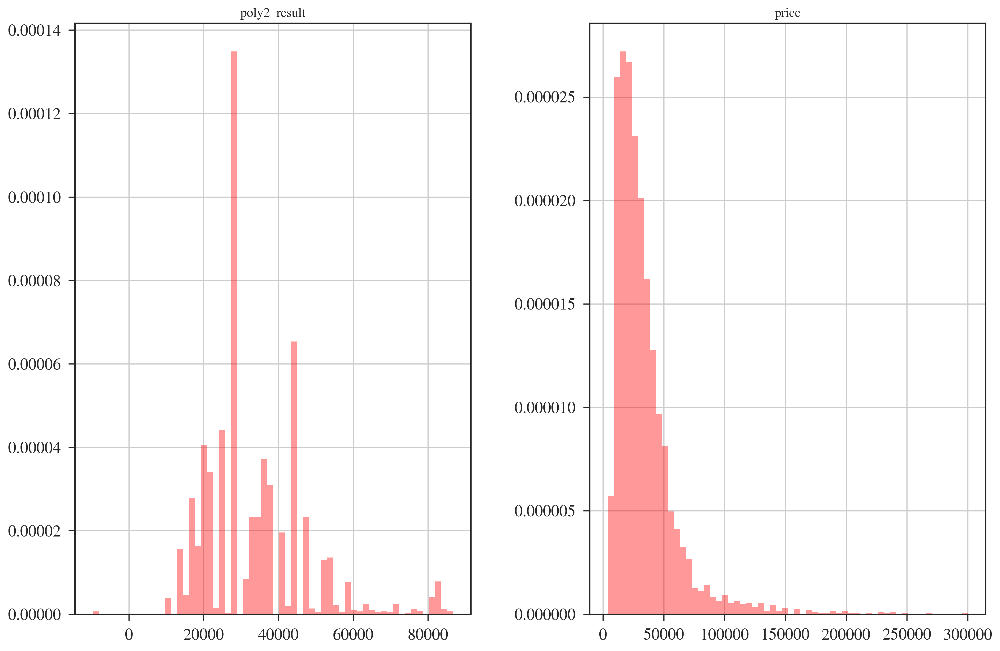

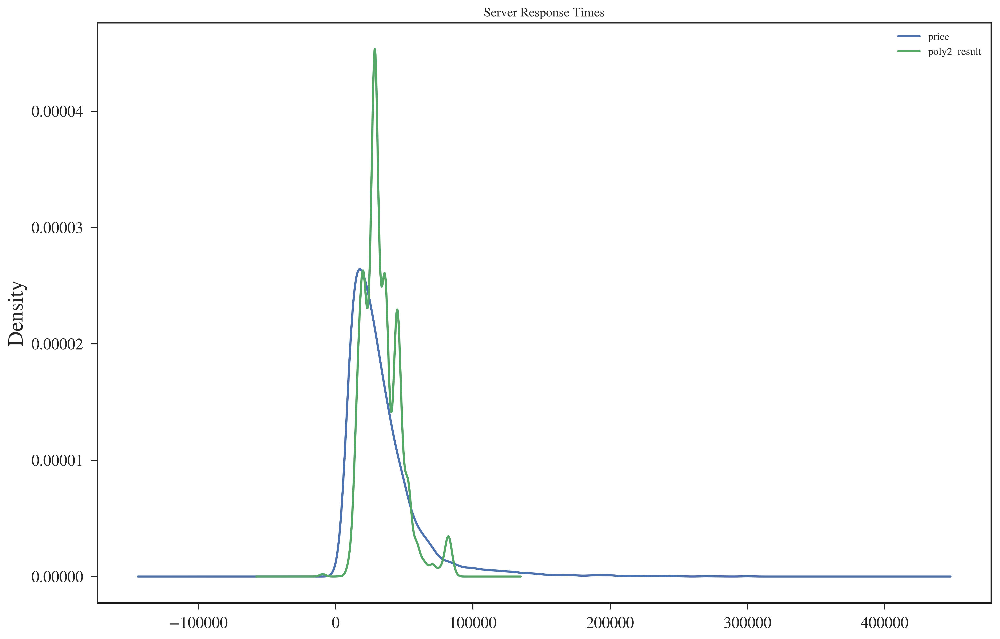

In [113]:
car_line_pre_result_poly2_compare.hist(bins=60, normed=True, alpha=0.4, color='red')
car_line_pre_result_poly2_compare.plot(kind='kde', title='Server Response Times', label='KDE pandas')

**use poly 3 to predict**

In [114]:
displacement_price_liner_result_poly3 = []
for i in car_line_pre.displacement:
    displacement_price_liner_p3_1 = pd.DataFrame({'displacement':[i]})
    displacement_price_liner_p3_12 = poly_2.predict(displacement_price_liner_p3_1)#得到一个array ，array([ 10455.93276865])
    
    displacement_price_liner_p3_12list1 = displacement_price_liner_p3_12.tolist()#转化成list
    displacement_price_liner_p3_12list12 = round(displacement_price_liner_p3_12list1[0],3)#取第里面的值，小数点后三位
    displacement_price_liner_result_poly3.append(displacement_price_liner_p3_12list12)#加到列中

In [115]:
car_line_pre_result.insert(3,'poly3_result',displacement_price_liner_result_poly3 )

In [116]:
car_line_pre_result.head()

,displacement,price,poly2_result,poly3_result
0,1798.0,12790,25291.960,25291.960
1,2000.0,16450,28796.235,28796.235
2,4461.0,49000,64768.556,64768.556
3,1797.0,16500,25274.404,25274.404
4,1968.0,18800,28246.681,28246.681


In [117]:
car_line_pre_result_poly3_compare = car_line_pre_result[['price','poly3_result']]#.sample(n=100)  

In [118]:
car_line_pre_result_poly3_compare = car_line_pre_result_poly3_compare.reset_index(drop=True)

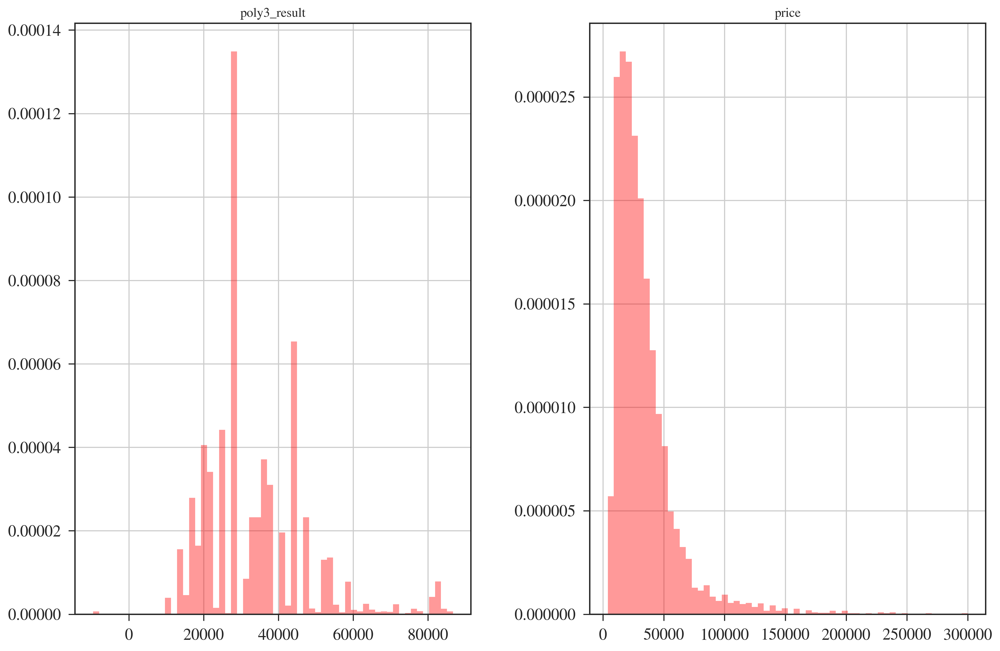

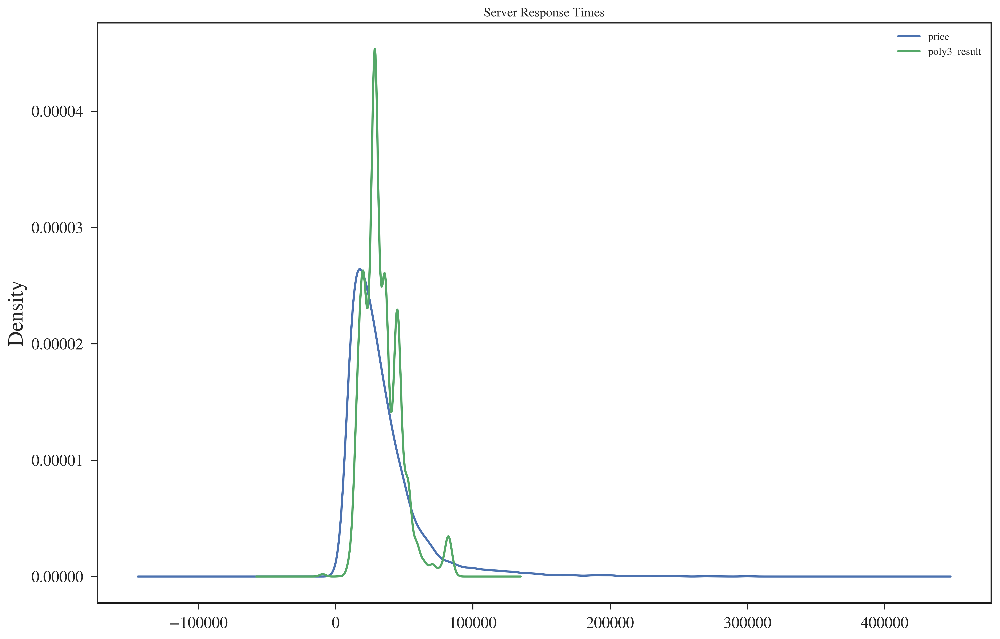

In [119]:
car_line_pre_result_poly3_compare.hist(bins=60, normed=True, alpha=0.4, color='red')
car_line_pre_result_poly3_compare.plot(kind='kde', title='Server Response Times', label='KDE pandas')

**According to the above two figures, we can see that there is a big difference between the predict results and the original results. It is not accurate to use this model and use kilometers to predict prices**

.

## 4.3 Predict the price based on displacement.Toyota cars. Used Knn model

In [120]:
car_knn_pre = car_full_data_anaPre_fueltype[car_full_data_anaPre_fueltype.brand == 'Toyota']


In [121]:
X = car_knn_pre.displacement.values
X = np.reshape(X, (len(car_knn_pre.displacement), 1))
y = car_knn_pre.price.values
y = np.reshape(y, (len(car_knn_pre.price), 1))

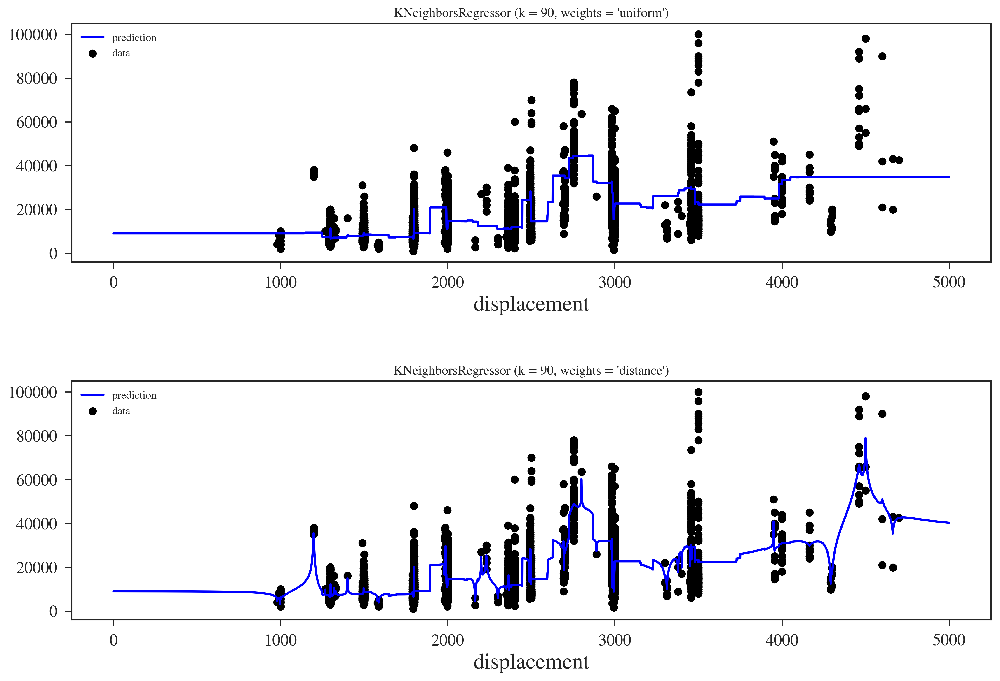

In [122]:
x = np.linspace(0, 5000, 8000)[:, np.newaxis]
n_neighbors = 90

for i, weights in enumerate(['uniform', 'distance']):
    knn = neighbors.KNeighborsRegressor(n_neighbors, weights=weights)
    y_hat = knn.fit(X, y).predict(x)
    
    plt.subplot(2, 1, i + 1)
    plt.scatter(X, y, c='k', label='data')
    plt.plot(x, y_hat, c='b', label='prediction')
    plt.axis('tight')
    plt.xlabel('displacement')
    #plt.ylabel('Total')
    plt.legend(loc='upper left')
    plt.title("KNeighborsRegressor (k = %i, weights = '%s')" % (n_neighbors, weights))
    plt.subplots_adjust( hspace=0.5)
    
plt.show()


**Next, compare the predicted results with the original data**

In [123]:
knn = neighbors.KNeighborsRegressor(n_neighbors=90, weights='uniform')
mod_knn_1 = knn.fit(X, y)

In [124]:
knn = neighbors.KNeighborsRegressor(n_neighbors, weights=weights)
y_hat = knn.fit(X, y).predict(x)

In [125]:
pre_displacement_price_result = []
for i in car_knn_pre.displacement:
    pre_displacement_price_result1 = pd.DataFrame({'car_knn_pre':[i]})
    pre_displacement_price_result2 = mod_knn_1.predict(pre_displacement_price_result1)
    pre_displacement_price_result2list = pre_displacement_price_result2.tolist()
    pre_displacement_price_result2list1 = round(pre_displacement_price_result2list[0][0],2)
    pre_displacement_price_result.append(pre_displacement_price_result2list1)

In [126]:
car_knn_pre.insert(11,'price_pre_result',pre_displacement_price_result)

In [127]:
#del car_knn_pre['price_pre_result']

In [128]:
car_knn_pre.head()

,name,brand,year,km,car_type,displacement,fuel,fuel_type,fuel_type_result,transmission,price,price_pre_result
1,Toyota Estima,Toyota,2008,109948,Van,2362.0,petrol,0,0,automatic,12500,11242.60
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,0,0,automatic,10990,11899.43
5,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,0,0,manual,12790,19987.24
9,Toyota Land Cruiser Td,Toyota,2011,118500,Ute,4461.0,diesel,1,0,manual,49000,34714.44
30,Toyota Corolla Fielder,Toyota,2004,130000,Station Wagon,1794.0,petrol,0,0,automatic,6500,6802.68


In [129]:
car_knn_pre_compare = car_knn_pre[['price','price_pre_result']]
car_knn_pre_compare = car_knn_pre_compare.reset_index(drop=True)

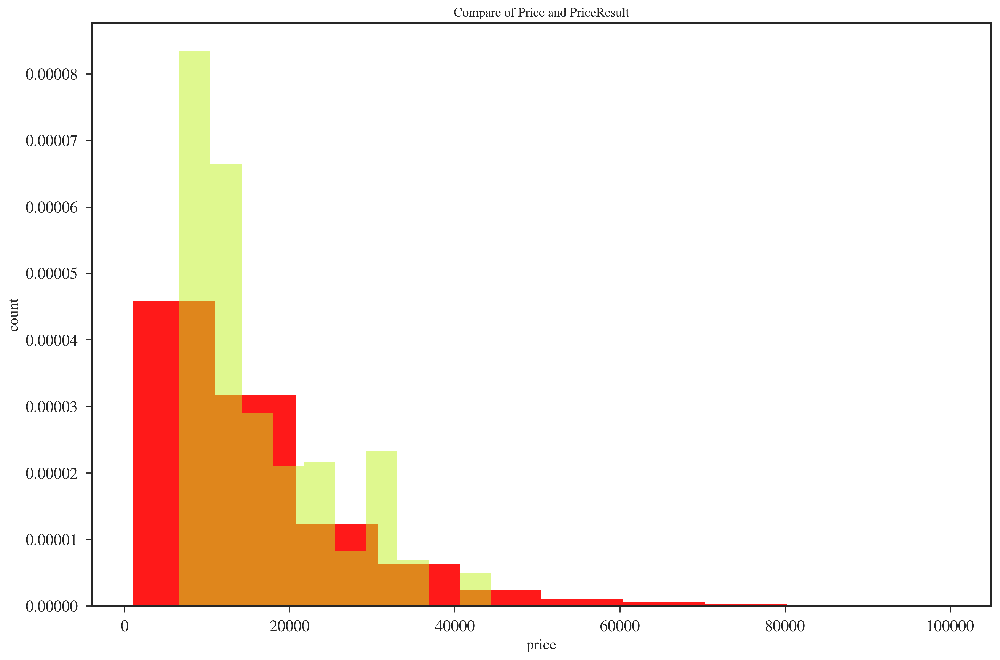

In [130]:
plt.hist(car_knn_pre_compare.price, normed=True, color="red", alpha=.9)
plt.hist(car_knn_pre_compare.price_pre_result, normed=True, color="#C1F320", alpha=.5)
plt.title('Compare of Price and PriceResult')
plt.xlabel('price', fontsize=14)
plt.ylabel('count', fontsize=14)
plt.legend(loc='upper right')

**According to the above figure, we can see that the predictable results are mainly concentrated in the vicinity of ten thousand. This result is not accurate, can only be used as a reference.**

.

## 4.4 Predict the car type based on displacement and fuel type petrol and diesel

In [131]:
import random
from sklearn.cluster import KMeans
from sklearn import preprocessing

In [132]:
car_full_data_anaPre2 = car_full_data_anaPre[car_full_data_anaPre.price <= 100000]
car_full_data_anaPre3 = car_full_data_anaPre2[(car_full_data_anaPre2.fuel == 'petrol') | (car_full_data_anaPre2.fuel == 'diesel')]
trytypelook2 = car_full_data_anaPre3.groupby('car_type').size()

In [133]:
trytypelook2

car_type
Convertible       193
Coupe             397
Hatchback        5694
Other              10
RV/SUV           3849
Sedan            3553
Station Wagon    3137
Ute              1389
Van              1740
dtype: int64

In [134]:
car_full_data_anaPre4 = car_full_data_anaPre3[(car_full_data_anaPre2.car_type == 'Hatchback') | (car_full_data_anaPre2.car_type == 'RV/SUV') | (car_full_data_anaPre2.car_type == 'Sedan')]


In [135]:
car_full_data_anaPre4.head()

,name,brand,year,km,car_type,displacement,fuel,transmission,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,1389.0,petrol,automatic,5500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,1300.0,petrol,automatic,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,2400.0,petrol,automatic,10990
4,Mazda Atenza,Mazda,2002,117000,Sedan,2260.0,petrol,tiptronic,7799
5,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,1798.0,petrol,manual,12790


In [136]:
fuel_type2 = []
for i in car_full_data_anaPre4.fuel:
    if i == 'petrol':
        fuel_type2.append(0)
    if i == 'diesel':
        fuel_type2.append(1)

In [137]:
car_full_data_anaPre4.insert(8,'fuel_type',fuel_type2)

In [138]:
car_type = []
for i in car_full_data_anaPre4.car_type:
    if i == 'Hatchback':
        car_type.append(0)
    if i == 'RV/SUV':
        car_type.append(1)
    if i == 'Sedan':
        car_type.append(2)

In [139]:
car_full_data_anaPre4.insert(5,'car_type_num',car_type)

In [140]:
car_full_data_anaPre4.head()

,name,brand,year,km,car_type,car_type_num,displacement,fuel,transmission,fuel_type,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,0,1389.0,petrol,automatic,0,5500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,0,1300.0,petrol,automatic,0,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,0,2400.0,petrol,automatic,0,10990
4,Mazda Atenza,Mazda,2002,117000,Sedan,2,2260.0,petrol,tiptronic,0,7799
5,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,0,1798.0,petrol,manual,0,12790


In [141]:
def eucledean_distance(x, y):
    d = 0.0
    
    for i in range(len(x)):
        d += (x[i] - y[i])**2
    d = math.sqrt(d)
    
    return d

In [142]:
def kmeans_cluster(rows, distance = eucledean_distance, k = 4, iter = 10):
    
    # Determine the minimum and maximum values for each point
    ranges=[(min([row[i] for row in rows]),max([row[i] for row in rows])) for i in range(len(rows[0]))]
    print ranges
    
    # Create k randomly placed centroids
    centroids=[[random.random( ) * (ranges[i][1] - ranges[i][0]) + ranges[i][0]  for i in range(len(rows[0]))] for j in range(k)]
    #centroids=[[4,70],[79,12],[68, 20]]
    print centroids
    
    prev_cluster_labels = None
    for t in range(iter):
        #print 'Iteration %d' % t
        cluster_labels = [[] for i in range(k)]
        #print cluster_labels
        # Find which centroid is the closest for each row
        for j in range(len(rows)):
            row = rows[j]
            best_match = 0
            for i in range(k):
                d = distance(centroids[i],row)
                if d < distance(centroids[best_match],row): 
                    best_match=i
            cluster_labels[best_match].append(j)
            
        # If the results are the same as last time, this is complete
        if cluster_labels == prev_cluster_labels:
            break
        prev_cluster_labels = cluster_labels
    
        # Move the centroids to the average of their members
        for i in range(k):
            avgs = [0.0] * len(rows[0])
            if len(cluster_labels[i]) > 0:
                for rowid in cluster_labels[i]:
                    for m in range(len(rows[rowid])):
                        avgs[m] += rows[rowid][m]
                for j in range(len(avgs)):
                    avgs[j] /= len(cluster_labels[i])
                centroids[i] = avgs
            
    return cluster_labels, centroids

**Then I try to find the best K value**

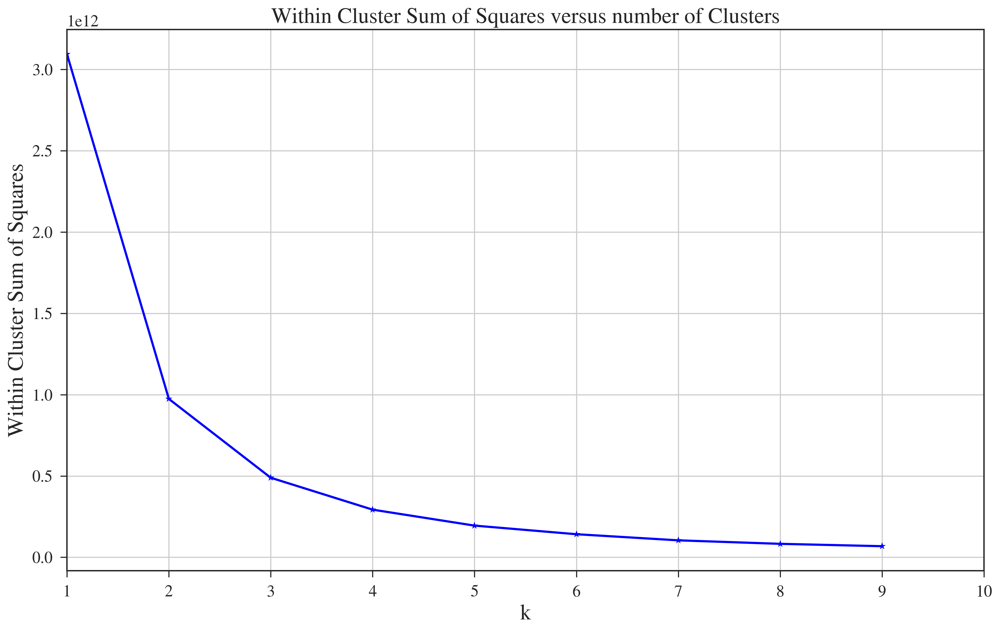

In [143]:
k_rng = range(1,10)
est = [KMeans(n_clusters = k).fit(car_full_data_anaPre4[['displacement','price']].values) for k in k_rng]

# Generally want to minimize WSS, while also minimizing k
within_cluster_sum_squares = [e.inertia_ for e in est]
fig, axes = plt.subplots()
fig.set_size_inches(15,20)
# Plot the results
plt.subplot(212)
plt.plot(k_rng, within_cluster_sum_squares, 'b*-')
plt.xlim([1,10])
plt.grid(True)
plt.xlabel('k', fontsize=20)
plt.ylabel('Within Cluster Sum of Squares', fontsize=20)
plt.title('Within Cluster Sum of Squares versus number of Clusters', fontsize=20)

**We think the best k value is 2. Because it is the most obvious turning point**

[(875.0, 6564.0), (500.0, 99995.0)]
[[3962.8959992777613, 91475.487077000435], [5660.0755024758591, 50106.874427301576]]


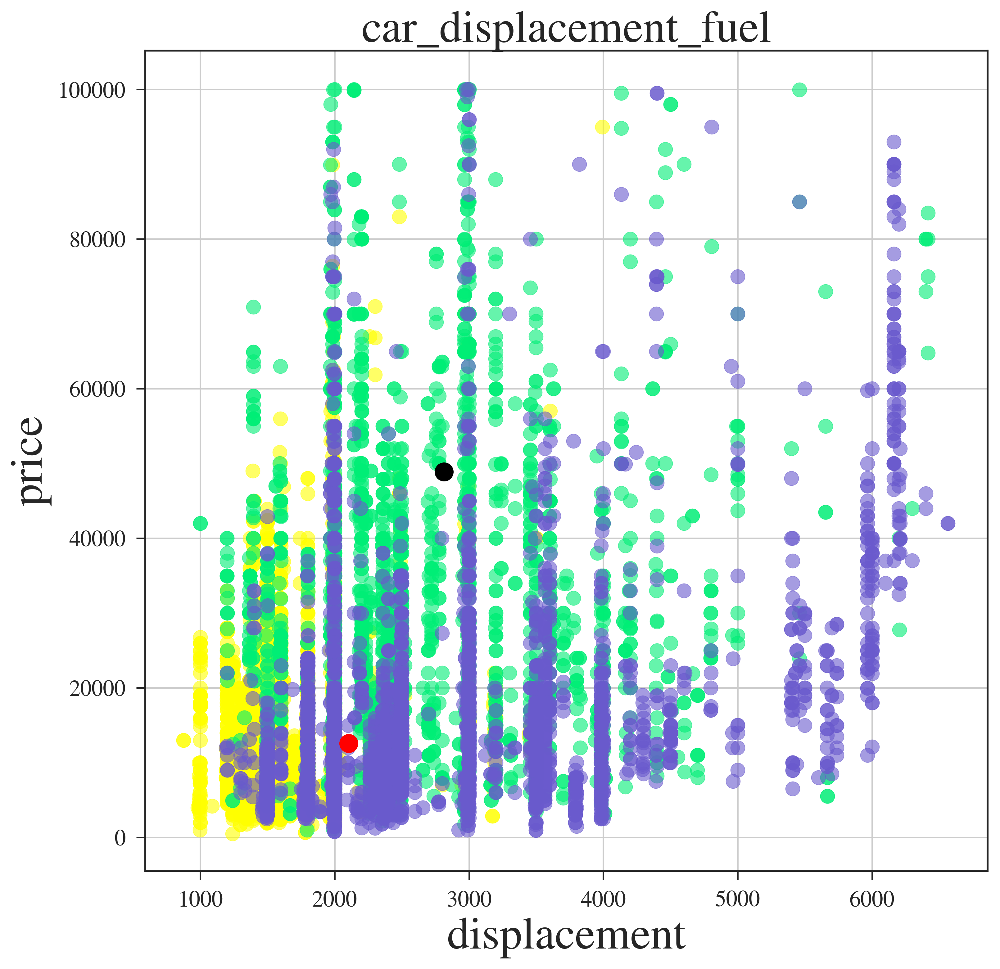

In [144]:
labels, centroids = kmeans_cluster(rows=car_full_data_anaPre4[['displacement','price']].values,k = 2)#, iter = 250)
#print labels, centroids
fig, axes = plt.subplots()
fig.set_size_inches(10,10)

axes.set_xlabel('displacement',fontsize=30)
axes.set_ylabel('price',fontsize=30)
plt.title('car_displacement_fuel',fontsize=30)
axes.grid()

axes.scatter(car_full_data_anaPre4.displacement.where(car_full_data_anaPre4.car_type_num == 0), car_full_data_anaPre4.price.where(car_full_data_anaPre4.car_type_num == 0), s=90, alpha=0.6, c='yellow')
axes.scatter(car_full_data_anaPre4.displacement.where(car_full_data_anaPre4.car_type_num == 1), car_full_data_anaPre4.price.where(car_full_data_anaPre4.car_type_num == 1), s=90, alpha=0.6, c='#00EE76')
axes.scatter(car_full_data_anaPre4.displacement.where(car_full_data_anaPre4.car_type_num == 2), car_full_data_anaPre4.price.where(car_full_data_anaPre4.car_type_num == 2), s=90, alpha=0.6, c='#6A5ACD')


axes.scatter(centroids[0][0], centroids[0][1], s=150, alpha=1, c='black')
axes.scatter(centroids[1][0], centroids[1][1], s=150, alpha=1, c='red')
#axes.scatter(centroids[2][0], centroids[2][1], s=150, alpha=1, c='black')
#axes.scatter(centroids[3][0], centroids[3][1], s=150, alpha=1, c='black')
#axes.scatter(centroids[4][0], centroids[4][1], s=150, alpha=1, c='black')
#axes.scatter(centroids[5][0], centroids[5][1], s=150, alpha=1, c='black')


plt.show()

In [145]:
km = KMeans(n_clusters=3, init='random')

In [146]:
km.fit(car_full_data_anaPre4[['displacement','price']].values)

KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [147]:
predictions = km.predict(car_full_data_anaPre4[['displacement','price']].values)
predictions

array([2, 2, 2, ..., 2, 2, 2])

In [148]:
car_type_pre_result = list(predictions)

In [149]:
car_full_data_anaPre4.insert(6,'car_type_pre_result',car_type_pre_result)

In [150]:
car_full_data_anaPre4.head()

,name,brand,year,km,car_type,car_type_num,car_type_pre_result,displacement,fuel,transmission,fuel_type,price
0,Volkswagen Polo 1.4,Volkswagen,2006,64000,Hatchback,0,2,1389.0,petrol,automatic,0,5500
2,Mazda Demio 2 /NEW SHAPE,Mazda,2009,76591,Hatchback,0,2,1300.0,petrol,automatic,0,6490
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,Toyota,2008,52241,Hatchback,0,2,2400.0,petrol,automatic,0,10990
4,Mazda Atenza,Mazda,2002,117000,Sedan,2,2,2260.0,petrol,tiptronic,0,7799
5,Toyota Corolla Gx,Toyota,2011,88800,Hatchback,0,2,1798.0,petrol,manual,0,12790


In [151]:
car_full_data_anaPre_compare = car_full_data_anaPre4[['car_type_num','car_type_pre_result']].sample(n=100)  

In [152]:
car_full_data_anaPre_compare =car_full_data_anaPre_compare.reset_index(drop=True)

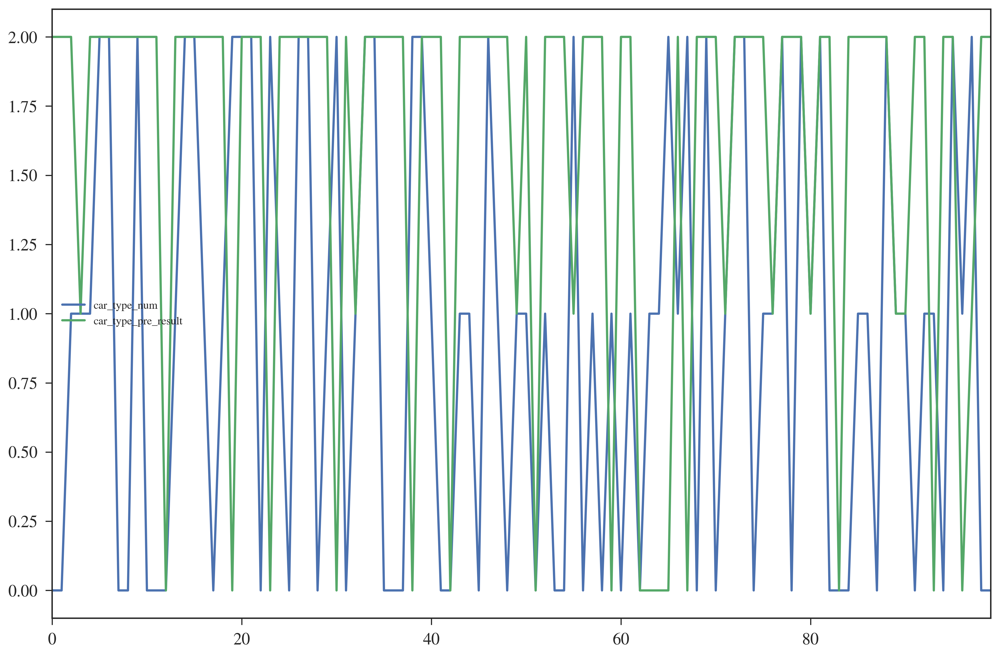

In [153]:
car_full_data_anaPre_compare.plot()

**From the above figure, we can see that the predict results and the original data have a big gap**

.

# Part 5 Application Price Prediction

**Regression algorithms seem to be working on features represented as numbers. So we need covert categories to numbers before building a predictive model.**

In [154]:
car_full_data.head()

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV/SUV,car_type_Sedan,car_type_Station Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
0,Volkswagen Polo 1.4,2006,64000,1389.0,5500,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
1,Toyota Estima,2008,109948,2362.0,12500,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0
2,Mazda Demio 2 /NEW SHAPE,2009,76591,1300.0,6490,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
3,Toyota Blade G/ BODYKIT/ LOW KMS/ REVERSE ...,2008,52241,2400.0,10990,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
5,Mazda Atenza,2002,117000,2260.0,7799,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1


In [155]:
car_full_data.columns

Index([u'name', u'year', u'km', u'displacement', u'price',
       u'car_type_Convertible', u'car_type_Coupe', u'car_type_Hatchback',
       u'car_type_Other', u'car_type_RV/SUV', u'car_type_Sedan',
       u'car_type_Station Wagon', u'car_type_Ute', u'car_type_Van',
       u'fuel_diesel', u'fuel_electric', u'fuel_hybrid', u'fuel_petrol',
       u'transmission_automatic', u'transmission_manual',
       u'transmission_tiptronic'],
      dtype='object')

**Rename columns to remove space in column name**

In [156]:
car_full_data=car_full_data.rename(columns = {'car_type_Station Wagon':'car_type_Station_Wagon'})
car_full_data=car_full_data.rename(columns = {'car_type_RV/SUV':'car_type_RV_SUV'})
car_full_data.columns

Index([u'name', u'year', u'km', u'displacement', u'price',
       u'car_type_Convertible', u'car_type_Coupe', u'car_type_Hatchback',
       u'car_type_Other', u'car_type_RV_SUV', u'car_type_Sedan',
       u'car_type_Station_Wagon', u'car_type_Ute', u'car_type_Van',
       u'fuel_diesel', u'fuel_electric', u'fuel_hybrid', u'fuel_petrol',
       u'transmission_automatic', u'transmission_manual',
       u'transmission_tiptronic'],
      dtype='object')

**The dataset indicates that some cars with an old history may have a very high price, the reason may be the very old car has a higher collection value. To avoid the affection by such unusual cases, we removed the cars whose mileage is larger than 150000 km or registered before the year 2000, thus the predictive model has a wider usability.
For electric cars, the displacement should not be considered to predict the price, so we will build 4 price predictive models according to the fuel type. **

In [157]:
car_train_data = car_full_data[(car_full_data.km < 150000) & (car_full_data.year > 2000)]

COnsidering the relationship between price and other parameters may be not linear, so we build polynomial regression models for predicting price.

## 5.1 Petrol Car Price Model

In [158]:
car_train_data_petrol = car_train_data[car_train_data.fuel_petrol == 1]
#generate the model 
petrol_mod = smf.ols(formula='price ~ 1 + year + I(year ** 2.0) + km +  I(km ** 2.0)'
              '+ displacement +  I(displacement ** 2.0) + car_type_Convertible + car_type_Coupe + car_type_Hatchback'
              '+ car_type_Other + car_type_RV_SUV + car_type_Sedan + car_type_Station_Wagon + car_type_Ute + car_type_Van'
              '+ transmission_automatic + transmission_manual + transmission_tiptronic',
              data=car_train_data_petrol.dropna()).fit()
petrol_mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.408
Model:                            OLS   Adj. R-squared:                  0.408
Method:                 Least Squares   F-statistic:                     678.1
Date:                Tue, 17 Oct 2017   Prob (F-statistic):               0.00
Time:                        17:52:36   Log-Likelihood:            -1.6581e+05
No. Observations:               14749   AIC:                         3.317e+05
Df Residuals:                   14733   BIC:                         3.318e+05
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                 -1.6706      0.088    -19.010      0.000      -1.843      -1.498
year                   -1742.6022     53.746    -32.423      0.000   -1847.952   -1637.253
I(year ** 2.0)             0.8709      0.027     32.669      0.000       0.819       0.923
km                        -0.3983      0.016    -24.500      0.000      -0.430      -0.366
I(km ** 2.0)            1.887e-06   1.02e-07     18.508      0.000    1.69e-06    2.09e-06
displacement              12.1184      0.263     46.135      0.000      11.604      12.633
I(displacement ** 2.0)    -0.0004    1.5e-05    -23.647      0.000      -0.000      -0.000
car_type_Convertible    1.039e+04   1908.910      5.441      0.000    6644.583    1.41e+04
car_type_Coupe           1.11e+04   1703.599      6.513      0.000    7756.730    1.44e+04
car_type_Hatchback     -3721.9148   1516.076     -2.455      0.014   -6693.614    -750.215
car_type_Other          1.201e+04   1.16e+04      1.034      0.301   -1.08e+04    3.48e+04
car_type_RV_SUV        -3154.6574   1516.880     -2.080      0.038   -6127.932    -181.383
car_type_Sedan         -7276.7910   1512.450     -4.811      0.000   -1.02e+04   -4312.201
car_type_Station_Wagon -4306.0837   1522.198     -2.829      0.005   -7289.781   -1322.386
car_type_Ute           -1.062e+04   2210.469     -4.803      0.000   -1.49e+04   -6283.237
car_type_Van           -4419.3503   1561.184     -2.831      0.005   -7479.465   -1359.235
transmission_automatic  -928.5722    301.750     -3.077      0.002   -1520.041    -337.104
transmission_manual     1256.6441    478.940      2.624      0.009     317.862    2195.427
transmission_tiptronic  -329.7425    414.343     -0.796      0.426   -1141.906     482.421
==============================================================================
Omnibus:                    36475.159   Durbin-Watson:                   1.921
Prob(Omnibus):                  0.000   Jarque-Bera (JB):       1091747567.736
Skew:                          26.239   Prob(JB):                         0.00
Kurtosis:                    1334.829   Cond. No.                     2.43e+25
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.88e-27. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [159]:
car_train_data_petrol.head(3)

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV_SUV,car_type_Sedan,car_type_Station_Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
0,Volkswagen Polo 1.4,2006,64000,1389.0,5500,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0
1,Toyota Estima,2008,109948,2362.0,12500,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0
2,Mazda Demio 2 /NEW SHAPE,2009,76591,1300.0,6490,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0


In [160]:
#test the mod
test_rows = car_train_data_petrol.head(3)
prediction_result = petrol_mod.predict(test_rows)
print prediction_result#.values

0     2660.963575
1    12747.601258
2     5254.413655
dtype: float64


**The result seems good, the Volkswagen Polo 1.4 of the year 2006 has the lowest price, which is same with the real data, the price of Toyota Estima of 2008 is predicted to be 12747 NZD which is very close to real price 12500, the Mazda Demio 2 of 2009 is also been predicted well. **

## 5.2 Diesel Car Price Model

In [161]:
car_train_data_diesel = car_train_data[car_train_data.fuel_diesel == 1]
len(car_train_data_diesel)

2455

**The rows number of diesel cars is not enough to build predictive model according to so many parameters, so we only take  year, km, displacement and transmission as the parameters to reduce mistake.**

In [162]:
#generate the model 
diesel_mod = smf.ols(formula='price ~ 1 + year + I(year ** 2.0) + km +  I(km ** 2.0)'
              '+ displacement +  I(displacement ** 2.0)'
              '+ transmission_automatic + transmission_manual + transmission_tiptronic',
              data=car_train_data_diesel.dropna()).fit()
diesel_mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.078
Model:                            OLS   Adj. R-squared:                  0.075
Method:                 Least Squares   F-statistic:                     29.38
Date:                Tue, 17 Oct 2017   Prob (F-statistic):           3.60e-39
Time:                        17:52:36   Log-Likelihood:                -30572.
No. Observations:                2455   AIC:                         6.116e+04
Df Residuals:                    2447   BIC:                         6.121e+04
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                 -1.0953      0.783     -1.399      0.162      -2.630       0.440
year                   -1098.5678    787.141     -1.396      0.163   -2642.099     444.963
I(year ** 2.0)             0.5511      0.390      1.412      0.158      -0.215       1.317
km                        -0.3296      0.109     -3.012      0.003      -0.544      -0.115
I(km ** 2.0)            9.934e-07   7.32e-07      1.357      0.175   -4.42e-07    2.43e-06
displacement               7.0918      9.494      0.747      0.455     -11.525      25.708
I(displacement ** 2.0)     0.0022      0.002      1.455      0.146      -0.001       0.005
transmission_automatic  3516.2453   2177.592      1.615      0.106    -753.868    7786.359
transmission_manual    -9800.9985   2517.163     -3.894      0.000   -1.47e+04   -4865.008
transmission_tiptronic  6283.6579   3591.839      1.749      0.080    -759.701    1.33e+04
==============================================================================
Omnibus:                     7387.521   Durbin-Watson:                   1.984
Prob(Omnibus):                  0.000   Jarque-Bera (JB):        413880183.329
Skew:                          42.745   Prob(JB):                         0.00
Kurtosis:                    2012.669   Cond. No.                     8.72e+24
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.88e-27. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [163]:
car_train_data_diesel.head(5)

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV_SUV,car_type_Sedan,car_type_Station_Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
10,Toyota Land Cruiser Td,2011,118500,4461.0,49000,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0
27,Nissan Navara ST 4x4 2.5 Diesel Manual 1 ONR,2010,109000,2488.0,27750,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0
52,Ford Fiesta 1.6D Manual,2013,83000,1600.0,14450,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0
59,Volkswagen Amarok Dc 4M Tl,2015,89000,1968.0,42000,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0
64,BMW X5,2010,44739,2996.0,40000,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0


In [164]:
#test the mod
test_rows = car_train_data_diesel.head(5)
prediction_result = diesel_mod.predict(test_rows)
print prediction_result#.values

10    60922.852753
27    16012.560009
52     8529.060496
59    28694.688879
64    50551.066261
dtype: float64


**The predictive result seems OK, the third row has the lowest price, the price of the second row is medium, and the first car is more expensive. It matches the real data through the value differs a bit.**

## 5.3 Hybrid Car Price Model

In [165]:
car_train_data_hybrid = car_train_data[car_train_data.fuel_hybrid == 1]
len(car_train_data_hybrid)

185

In [166]:
#generate the model 
hybrid_mod = smf.ols(formula='price ~ 1 + year + I(year ** 2.0) + km +  I(km ** 2.0)'
              '+ displacement +  I(displacement ** 2.0)'
              '+ transmission_automatic + transmission_manual + transmission_tiptronic',
              data=car_train_data_hybrid.dropna()).fit()
hybrid_mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.563
Model:                            OLS   Adj. R-squared:                  0.548
Method:                 Least Squares   F-statistic:                     38.18
Date:                Tue, 17 Oct 2017   Prob (F-statistic):           1.41e-29
Time:                        17:52:36   Log-Likelihood:                -1943.3
No. Observations:                 185   AIC:                             3901.
Df Residuals:                     178   BIC:                             3923.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept                 -2.6690      0.332     -8.031      0.000      -3.325      -2.013
year                   -2688.4193    334.094     -8.047      0.000   -3347.714   -2029.124
I(year ** 2.0)             1.3351      0.166      8.052      0.000       1.008       1.662
km                        -0.3196      0.076     -4.182      0.000      -0.470      -0.169
I(km ** 2.0)            1.318e-06   5.38e-07      2.450      0.015    2.57e-07    2.38e-06
displacement              23.4980      5.923      3.967      0.000      11.809      35.187
I(displacement ** 2.0)    -0.0019      0.001     -1.608      0.110      -0.004       0.000
transmission_automatic  2565.0389   1816.574      1.412      0.160   -1019.753    6149.831
transmission_manual             0          0        nan        nan           0           0
transmission_tiptronic -2567.7079   1816.577     -1.413      0.159   -6152.506    1017.090
==============================================================================
Omnibus:                      266.998   Durbin-Watson:                   1.847
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            25871.970
Skew:                           6.240   Prob(JB):                         0.00
Kurtosis:                      59.574   Cond. No.                          inf
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is      0. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [167]:
car_train_data_hybrid.head(5)

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV_SUV,car_type_Sedan,car_type_Station_Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
11,Toyota Prius G,2012,88023,1797.0,16500,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0
58,"Toyota Aqua Hybrid,",2013,92400,1496.0,10990,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0
83,Toyota Prius **6 Airbags+Rev Cam+Parking S...,2012,92200,1800.0,13500,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0
205,Honda Insight,2010,147744,1339.0,7900,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0
414,Lexus RX 400h RX400h Hybrid,2006,72800,3311.0,19990,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0


In [168]:
#test the mod
test_rows = car_train_data_hybrid.head(5)
prediction_result = hybrid_mod.predict(test_rows)
print prediction_result#.values

11     16254.930473
58     13379.684100
83     15962.457492
205     2314.745429
414    22821.236206
dtype: float64


**Comparing the prediction result with the first 5 rows of original data, the predictive model works good.**

## 5.4 Electric Car Price Model

In [169]:
car_train_data_electric = car_train_data[car_train_data.fuel_electric == 1]
len(car_train_data_electric)

18

**Electric cars data set is very small, considering displacement and transmission make no sense for an electric engine, we will build the model by only year and km.**

In [170]:
#generate the model 
electric_mod = smf.ols(formula='price ~ 1 + year + I(year ** 2.0) + km +  I(km ** 2.0)',
              data=car_train_data_electric.dropna()).fit()
electric_mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.623
Model:                            OLS   Adj. R-squared:                  0.506
Method:                 Least Squares   F-statistic:                     5.360
Date:                Tue, 17 Oct 2017   Prob (F-statistic):            0.00897
Time:                        17:52:36   Log-Likelihood:                -198.96
No. Observations:                  18   AIC:                             407.9
Df Residuals:                      13   BIC:                             412.4
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept       1.569e+10   7.01e+09      2.238      0.043    5.42e+08    3.08e+10
year           -1.559e+07   6.96e+06     -2.239      0.043   -3.06e+07   -5.46e+05
I(year ** 2.0)  3873.3565   1729.235      2.240      0.043     137.571    7609.142
km                -0.7489      1.613     -0.464      0.650      -4.235       2.737
I(km ** 2.0)    1.962e-05    4.9e-05      0.401      0.695   -8.62e-05       0.000
==============================================================================
Omnibus:                        3.441   Durbin-Watson:                   1.553
Prob(Omnibus):                  0.179   Jarque-Bera (JB):                1.583
Skew:                           0.661   Prob(JB):                        0.453
Kurtosis:                       3.604   Cond. No.                     6.66e+14
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 6.58e-12. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [171]:
car_train_data_electric.head(5)

,name,year,km,displacement,price,car_type_Convertible,car_type_Coupe,car_type_Hatchback,car_type_Other,car_type_RV_SUV,car_type_Sedan,car_type_Station_Wagon,car_type_Ute,car_type_Van,fuel_diesel,fuel_electric,fuel_hybrid,fuel_petrol,transmission_automatic,transmission_manual,transmission_tiptronic
4422,Nissan Leaf Gen 2 S,2013,19752,1.0,17250,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0
4565,Nissan e-NV200 5 Seater 100% Electric!!,2015,4547,1000.0,21950,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0
4983,Nissan Leaf Gen 2,2015,14240,1.0,19999,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0
6953,Nissan Leaf 30 kWh - Model S - Zero Emissions,2015,19500,1.0,25750,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0
6954,Nissan Leaf 30 kWh - UK - Acenta - Zero Em...,2016,14500,1.0,33900,0,0,1,0,0,0,0,0,0,0,1,0,0,1,0,0


In [172]:
#test the mod
test_rows = car_train_data_electric.head(5)
prediction_result = electric_mod.predict(test_rows)
print prediction_result#.values

4422      348.302495
4565    26599.060865
4983    22912.175876
6953    22454.372992
6954    45539.807294
dtype: float64


**The result seems acceptable since the predictive values match the original prices except that the first predictive price is much lower.**

**The models are totally good for estimating the price of the used car.
Now we have 4 price predictive models based on different power source, we will develop a simple windows application via C#, so that users could estimate the price of his.her used car via the application. Please find the application from folder "Application".**

.

# Part 6 Application

**Please find the source code and installer of the application from folder "UsedCarPriceEstimate".**

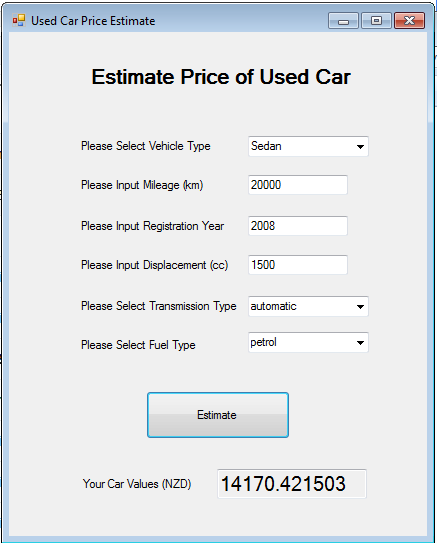

In [173]:
from IPython.display import Image
Image(filename='application.png')

In [174]:
# Save models for windows application
import pickle

# save the models to disk
filename = 'petrol_mod.sav'
pickle.dump(petrol_mod, open(filename, 'wb'))

filename = 'diesel_mod.sav'
pickle.dump(diesel_mod, open(filename, 'wb'))

filename = 'hybrid_mod.sav'
pickle.dump(hybrid_mod, open(filename, 'wb'))

filename = 'electric_mod.sav'
pickle.dump(electric_mod, open(filename, 'wb'))


**We implement an application for better user experience. The application is developed by C# and Python, user could input parameters of his car via input control, then the parameters will be passed to the python script "predict.py", the script loads the predictive models above and predict the value.
The minimum price is 1250 since we think that even worst car should have a minimum value.**

.

# Conclusion

**We concluded through the analysis, in the New Zealand second-hand car market, the proportion of Japanese cars is high. In particular, Toyota cars, every year of the model has a large number of used cars in the sale.The Hatchback, RV/SUV and Sedan are three most popular car type in NewZealand. In the used car market, around the car in 2005 accounted for the vast majority. This shows that many users choose to change a car every ten years. Similarly, used cars which have about 100,000km also accounted for the largest in the used car market. One hundred thousand kilometers is a watershed of used cars, many people sell the car when the car reached 100,000 km. In New Zealand, the vast majority of cars are petrol cars. However, in recent years, the market there has been some new energy vehicles, such as hybrid cars and electric cars. But the number of new energy vehicles is still very small, almost negligible. In the next few years, the number of new energy used cars may increase. In New Zealand's used cars, the displacement is mainly concentrated between 2000cc and 3000cc. Perhaps this range of displacement enough to cope with most mountainous roads in New Zealand, and fuel consumption will not be very high.Horton as the largest car brand in the Southern Hemisphere is very competitive in the market. In the Trademe used car,  the number of 16 years and 17 years used cars have a certain rate of growth. These cars are almost new cars. **

# Thank You!